In [ ]:
!git clone https://github.com/clovaai/deep-text-recognition-benchmark.git

Cloning into 'deep-text-recognition-benchmark'...
remote: Enumerating objects: 499, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 499 (delta 0), reused 1 (delta 0), pack-reused 495 (from 1)
Receiving objects: 100% (499/499), 3.07 MiB | 13.98 MiB/s, done.
Resolving deltas: 100% (302/302), done.


In [ ]:
pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.0/882.0 kB 15.3 MB/s eta 0:00:00


In [ ]:
# !pip uninstall torch torchvision torchaudio -y
# !pip install torch torchvision torchaudio

Found existing installation: torch 2.4.1+cu121
Uninstalling torch-2.4.1+cu121:
  Successfully uninstalled torch-2.4.1+cu121
Found existing installation: torchvision 0.19.1+cu121
Uninstalling torchvision-0.19.1+cu121:
  Successfully uninstalled torchvision-0.19.1+cu121
Found existing installation: torchaudio 2.4.1+cu121
Uninstalling torchaudio-2.4.1+cu121:
  Successfully uninstalled torchaudio-2.4.1+cu121
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 797.1/797.1 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 94.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 88.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 55.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [ ]:
# 셀 1: 필요한 라이브러리 설치
!pip install easyocr
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 25.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 29.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 281.3/281.3 kB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.5/882.5 kB 14.0 MB/s eta 0:00:00


# 라벨링

In [ ]:
import os
import glob
import re
import shutil

def convert_yolo_to_easyocr_interactive(yolo_label_dir, easyocr_output_dir):
    # YOLO 라벨 파일들을 찾습니다.
    yolo_files = glob.glob(os.path.join(yolo_label_dir, '*.txt'))

    # 파일명이 001부터 010으로 끝나는 파일만 필터링합니다.
    # 2017로 시작하고 001부터 010으로 끝나는 파일만 필터링합니다.
    filtered_files = [f for f in yolo_files if re.search(r'^201402.*0(0[1-9]|10)\.txt$', os.path.basename(f))]

    # EasyOCR 출력 디렉토리 구조를 생성합니다.
    easyocr_label_dir = os.path.join(easyocr_output_dir, 'labels')

    easyocr_image_dir = os.path.join(easyocr_output_dir, 'images')
    os.makedirs(easyocr_label_dir, exist_ok=True)
    os.makedirs(easyocr_image_dir, exist_ok=True)

    print(f"라벨 디렉토리: {easyocr_label_dir}")
    print(f"이미지 디렉토리: {easyocr_image_dir}")

    for yolo_file in filtered_files:
        base_name = os.path.basename(yolo_file)
        image_name = base_name.replace('.txt', '.jpg')

        # 이미지 파일 경로를 찾습니다.
        image_file = os.path.join(os.path.dirname(yolo_label_dir), 'images', image_name)

        if not os.path.exists(image_file):
            print(f"경고: {image_name} 파일을 찾을 수 없습니다. 건너뜁니다.")
            continue

        print(f"\n처리 중인 파일: {base_name}")

        # 사용자로부터 텍스트 입력 받기 또는 건너뛰기
        user_input = input(f"{image_name}의 텍스트를 입력하세요 (건너뛰려면 's' 입력): ")

        if user_input.lower() == 's':
            print(f"{image_name} 건너뛰기")
            continue

        # 텍스트 파일 처리
        easyocr_label_file = os.path.join(easyocr_label_dir, base_name)
        try:
            with open(yolo_file, 'r') as yolo_f, open(easyocr_label_file, 'w') as easyocr_f:
                for line in yolo_f:
                    parts = line.strip().split()
                    if len(parts) == 5:  # YOLO 형식 확인
                        _, x_center, y_center, width, height = parts
                        new_line = f"0 {x_center} {y_center} {width} {height} {user_input}\n"
                        easyocr_f.write(new_line)
            print(f"텍스트 파일 저장 완료: {easyocr_label_file}")
        except Exception as e:
            print(f"텍스트 파일 저장 중 오류 발생: {str(e)}")

        # 이미지 파일 복사
        try:
            shutil.copy2(image_file, os.path.join(easyocr_image_dir, image_name))
            print(f"이미지 파일 복사 완료: {image_name}")
        except Exception as e:
            print(f"이미지 파일 복사 중 오류 발생: {str(e)}")

        print(f"{base_name} 처리 완료")

    print("모든 파일 변환이 완료되었습니다.")


# 사용 예:
yolo_label_dir = '/content/drive/MyDrive/dataset/train/labels'
easyocr_output_dir = '/content/drive/MyDrive/EASY/dataset/valid'
convert_yolo_to_easyocr_interactive(yolo_label_dir, easyocr_output_dir)


KeyboardInterrupt: 

# easy ocr 기존 모델 가져와 추가 학습

In [ ]:
import os
import yaml
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau  # 이 줄을 추가하세요
from PIL import Image
import numpy as np
import easyocr
import cv2
from torchvision import transforms
import multiprocessing
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

print(f"CUDA 사용 가능: {torch.cuda.is_available()}")
print(f"CUDA 버전: {torch.version.cuda}")

# Google Drive 마운트
from google.colab import drive
drive.mount('/content/drive')

# YAML 설정 파일 로드
with open('/content/drive/MyDrive/EASY/config.yaml', 'r') as f:
    config = yaml.safe_load(f)

print("설정 로드 완료:")
print(config)

# CUDA 사용 시 멀티프로세싱 방식 변경
if config['misc']['use_cuda']:
    multiprocessing.set_start_method('spawn', force=True)

class OCRDataset(Dataset):
    def __init__(self, data_dir, config, reader):
        self.image_dir = os.path.join(data_dir, 'images')
        self.label_dir = os.path.join(data_dir, 'labels')
        self.image_files = [f for f in os.listdir(self.image_dir) if f.endswith(tuple(config['dataset']['image_extensions']))]
        self.config = config
        self.reader = reader
        # 이미지 전처리를 위한 변환 정의
        self.transform = transforms.Compose([
            transforms.Grayscale(),  # 흑백 변환
            transforms.Resize((224, 224)),  # 모든 이미지를 224x224로 리사이즈
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,))  # 정규화
        ])

    def preprocess_image(self, image):
        # OpenCV를 사용한 추가 전처리
        image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2GRAY)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        image = clahe.apply(image)
        return Image.fromarray(image)

    def __getitem__(self, idx):
        try:
            image_name = self.image_files[idx]
            image_path = os.path.join(self.image_dir, image_name)
            label_path = os.path.join(self.label_dir, os.path.splitext(image_name)[0] + self.config['dataset']['label_extension'])

            # 이미지 로드 및 전처리
            image = Image.open(image_path).convert('RGB')
            image = self.preprocess_image(image)
            image = self.transform(image)

            # EasyOCR을 사용하여 텍스트 인식 (전처리된 이미지 사용)
            result = self.reader.readtext(np.array(image.squeeze(), dtype=np.uint8))
            recognized_text = ' '.join([text for _, text, _ in result])

            # 인식된 텍스트가 없으면 특별한 토큰 사용
            if not recognized_text:
                recognized_text = "<EMPTY>"

            with open(label_path, 'r', encoding='utf-8') as f:
                true_label = f.read().strip()

            # 레이블 파싱
            label_parts = true_label.split()
            if len(label_parts) >= 5:
                bbox = torch.tensor([float(x) for x in label_parts[1:5]])
                text_label = ' '.join(label_parts[5:]) if len(label_parts) > 5 else ""
            else:
                print(f"경고: {image_name}에 대한 레이블 형식이 잘못되었습니다. 기본값을 사용합니다.")
                bbox = torch.tensor([0.0, 0.0, 1.0, 1.0])  # 기본 바운딩 박스
                text_label = ""

            def char_to_index(c):
                if 'A' <= c <= 'Z':
                    return ord(c) - ord('A')
                elif 'a' <= c <= 'z':
                    return ord(c) - ord('a') + 26
                elif '0' <= c <= '9':
                    return ord(c) - ord('0') + 52
                else:
                    return 62  # 알 수 없는 문자나 패딩

            # recognized_text를 인코딩 (최대 50자)
            encoded_recognized_text = torch.tensor([char_to_index(c) for c in recognized_text[:50].ljust(50, ' ')], dtype=torch.long)

            # text_label 인코딩 (최대 50자)
            encoded_label = torch.tensor([char_to_index(c) for c in text_label[:50].ljust(50, ' ')], dtype=torch.long)

            return image, encoded_recognized_text, bbox, encoded_label

        except Exception as e:
            print(f"항목 {idx} 처리 중 오류 발생: {str(e)}")
            return None

    def __len__(self):
        return len(self.image_files)

class OCRModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super(OCRModel, self).__init__()
        self.embedding = nn.Embedding(input_size, hidden_size)
        self.lstm = nn.LSTM(hidden_size, hidden_size, num_layers=2, batch_first=True, bidirectional=True, dropout=0.5)
        self.attention = nn.MultiheadAttention(hidden_size * 2, num_heads=4)
        self.fc_text = nn.Sequential(
            nn.Linear(hidden_size * 2, hidden_size),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(hidden_size, num_classes)
        )
        self.fc_bbox = nn.Sequential(
            nn.Linear(hidden_size * 2, hidden_size),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(hidden_size, 4)
        )

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        attn_out, _ = self.attention(lstm_out, lstm_out, lstm_out)
        text_output = self.fc_text(attn_out)
        bbox_output = self.fc_bbox(attn_out[:, -1, :])
        return text_output, bbox_output

def validate_model(model, val_loader, text_criterion, bbox_criterion, device):
    model.eval()
    total_loss = 0
    vocab_size = 63  # 영문 대소문자(52) + 숫자(10) + 알 수 없는 문자/패딩(1)

    with torch.no_grad():
        for images, recognized_texts, bboxes, text_labels in val_loader:
            images = images.to(device)
            recognized_texts = recognized_texts.to(device)
            bboxes = bboxes.to(device)
            text_labels = text_labels.to(device)

            bboxes = bboxes.float()

            text_outputs, bbox_outputs = model(recognized_texts)

            # 텍스트 예측 및 손실 계산
            text_outputs = text_outputs.log_softmax(2).transpose(0, 1)
            input_lengths = torch.full((text_outputs.size(1),), text_outputs.size(0), dtype=torch.long).to(device)
            target_lengths = torch.sum(text_labels != vocab_size-1, dim=1).to(device)
            text_loss = text_criterion(text_outputs, text_labels, input_lengths, target_lengths)
            bbox_loss = bbox_criterion(bbox_outputs, bboxes)

            loss = text_loss + bbox_loss
            total_loss += loss.item()

    return total_loss / len(val_loader)

def train_custom_model(config):
    # EasyOCR Reader 초기화 (영어만 인식)
    reader = easyocr.Reader(['en'], gpu=config['misc']['use_cuda'])

    # 데이터셋 및 데이터 로더 초기화
    train_dataset = OCRDataset(config['dataset']['train_data_dir'], config, reader)
    train_loader = DataLoader(train_dataset, batch_size=config['training']['batch_size'],
                              shuffle=True, num_workers=0 if config['misc']['use_cuda'] else config['misc']['num_workers'])

    # 모델 초기화
    vocab_size = 63  # 영문 대소문자(52) + 숫자(10) + 알 수 없는 문자/패딩(1)
    hidden_size = 128
    num_classes = vocab_size
    model = OCRModel(vocab_size, hidden_size, num_classes)

    device = torch.device("cuda" if config['misc']['use_cuda'] and torch.cuda.is_available() else "cpu")
    model.to(device)

    # 옵티마이저 설정
    optimizer = getattr(torch.optim, config['training']['optimizer'])(
        model.parameters(), lr=config['training']['learning_rate'])

    # 손실 함수 설정
    text_criterion = nn.CTCLoss(blank=vocab_size-1, zero_infinity=True)
    bbox_criterion = nn.MSELoss()

    # 학습률 스케줄러 추가
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

    # 조기 종료를 위한 변수
    best_loss = float('inf')
    patience = 10
    patience_counter = 0

    # 학습 루프
    for epoch in range(config['training']['num_epochs']):
        print(f"에포크 {epoch+1}/{config['training']['num_epochs']} 시작")

        for batch_idx, (images, recognized_texts, bboxes, text_labels) in enumerate(train_loader):
            if recognized_texts is None or recognized_texts.nelement() == 0:
                print(f"빈 배치 {batch_idx} 건너뛰기")
                continue

            # 데이터를 디바이스로 이동
            images = images.to(device)
            recognized_texts = recognized_texts.to(device)
            bboxes = bboxes.to(device)
            text_labels = text_labels.to(device)

            bboxes = bboxes.float()

            optimizer.zero_grad()
            text_outputs, bbox_outputs = model(recognized_texts)

            # 텍스트 예측 및 손실 계산
            text_outputs = text_outputs.log_softmax(2).transpose(0, 1)
            input_lengths = torch.full((text_outputs.size(1),), text_outputs.size(0), dtype=torch.long).to(device)
            target_lengths = torch.sum(text_labels != vocab_size-1, dim=1).to(device)
            text_loss = text_criterion(text_outputs, text_labels, input_lengths, target_lengths)
            bbox_loss = bbox_criterion(bbox_outputs, bboxes)

            # 손실 합산 및 역전파
            loss = text_loss + bbox_loss
            loss.backward()

            # 그래디언트 클리핑 적용
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            if batch_idx % 10 == 0:
                print(f"에포크 {epoch+1}/{config['training']['num_epochs']}, 배치 {batch_idx}, 손실: {loss.item():.4f}")

        print(f"에포크 {epoch+1}/{config['training']['num_epochs']} 완료")

        # 모델 저장
        if (epoch + 1) % config['save']['save_interval'] == 0:
            save_path = os.path.join(config['save']['output_dir'], f'custom_model_epoch_{epoch+1}.pth')
            torch.save(model.state_dict(), save_path)
            print(f"모델 저장됨: {save_path}")



    # 최종 모델 저장
    final_save_path = os.path.join(config['save']['output_dir'], 'final_custom_model.pth')
    torch.save(model.state_dict(), final_save_path)
    print(f"최종 모델 저장됨: {final_save_path}")

if __name__ == '__main__':
    # 학습 실행
    train_custom_model(config)

CUDA 사용 가능: True
CUDA 버전: 12.1
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
설정 로드 완료:
{'dataset': {'train_data_dir': '/content/drive/MyDrive/EASY/dataset/train', 'val_data_dir': '/content/drive/MyDrive/EASY/dataset/valid', 'image_extensions': ['.jpg'], 'label_extension': '.txt'}, 'model': {'craft': {'pretrained_path': '/path/to/pretrained/craft_model.pth', 'fine_tune_layers': 2}, 'moran': {'pretrained_path': '/path/to/pretrained/moran_model.pth', 'fine_tune_layers': 2}}, 'training': {'batch_size': 8, 'num_epochs': 30, 'learning_rate': 5e-05, 'optimizer': 'Adam', 'loss_function': 'CTCLoss', 'gradient_clip_value': 0.5}, 'preprocessing': {'grayscale': True, 'normalize': True}, 'save': {'output_dir': '/content/drive/MyDrive/EASY/model', 'save_interval': 5}, 'misc': {'seed': 42, 'num_workers': 4, 'use_cuda': True}}
에포크 1/30 시작
에포크 1/30, 배치 0, 손실: 59.4905
에포크 1/30, 배치 10, 손실: 61.0904
에포크 1/30, 배치 20, 손실: 71.2

# easy  모델 테스트

In [ ]:
## 초안
import easyocr

import cv2
import numpy as np

def preprocess_image(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    denoised = cv2.fastNlMeansDenoising(gray)
    thresh = cv2.threshold(denoised, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    return thresh



# 사용자 정의 모델을 불러오기 위해 model_storage_directory에 모델 저장 경로를 설정
# recog_network에 학습된 네트워크 이름을 설정
reader = easyocr.Reader(
    ['en'],  # 언어 설정
    model_storage_directory='/content/drive/MyDrive/EASY/model',  # 모델이 저장된 경로
    recog_network='english_g2',  # 학습 시 기본 네트워크
    gpu=config['misc']['use_cuda']  # GPU 사용 여부
)

# 테스트할 이미지 경로
image_path = '/content/drive/MyDrive/EASY/dataset/train/images/198301052_001.jpg'

# 이미지에서 텍스트 인식
result = reader.readtext(image_path)

# 결과 출력
for (bbox, text, prob) in result:
    print(f"Detected text: {text}, Confidence: {prob}")

# 전처리된 이미지로 OCR 수행
preprocessed_image = preprocess_image(image_path)
result = reader.readtext(preprocessed_image)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete
Processing 198301052_010.jpg:

0: 480x640 1 pill, 33.4ms
Speed: 11.9ms preprocess, 33.4ms inference, 731.9ms postprocess per image at shape (1, 3, 480, 640)
Detected text: SL, Confidence: 0.6505240360603861
Detected text: 285, Confidence: 0.3229846954345703


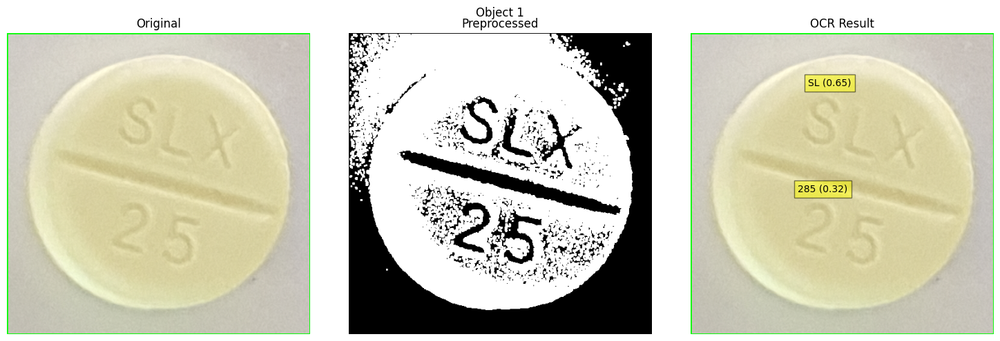


Processing 200308578_010.jpg:

0: 480x640 1 pill, 7.5ms
Speed: 3.2ms preprocess, 7.5ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
Detected text: vS, Confidence: 0.35612099191958646


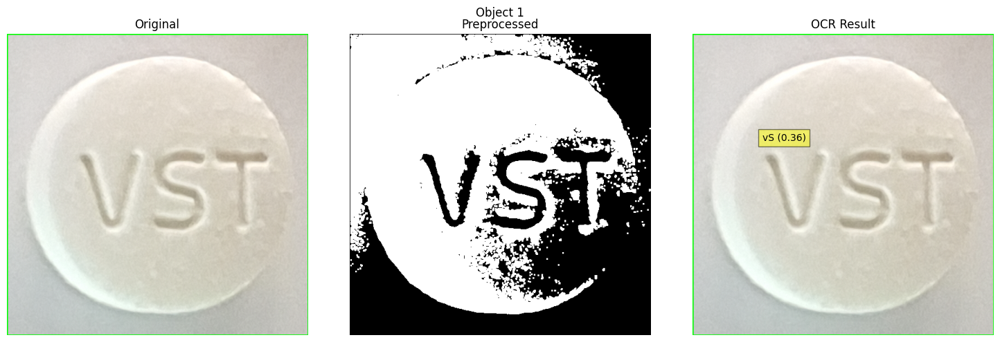


Processing 198500049_009.jpg:

0: 480x640 1 pill, 6.7ms
Speed: 3.0ms preprocess, 6.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Detected text: VM5O, Confidence: 0.5150015354156494


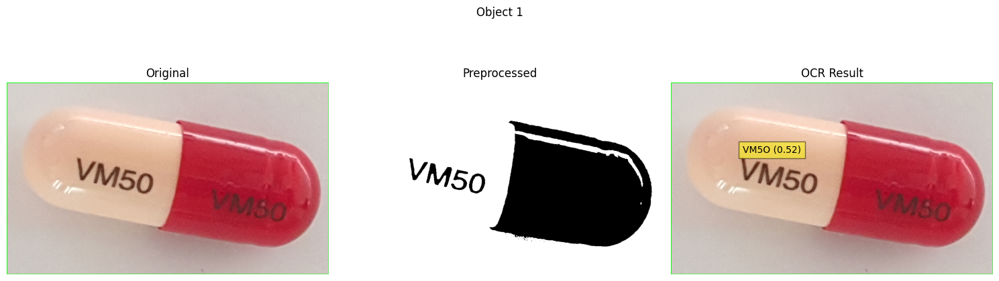


Processing 198500050_005.jpg:

0: 480x640 1 pill, 8.9ms
Speed: 4.0ms preprocess, 8.9ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
Detected text: VM, Confidence: 0.9971337016598408


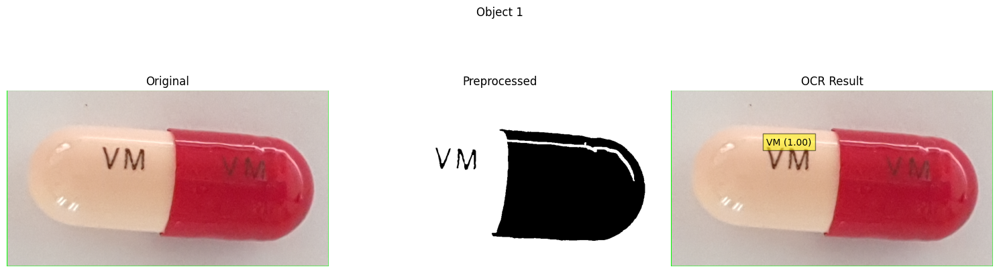


Processing 11.jpg:

0: 544x640 (no detections), 35.6ms
Speed: 1.9ms preprocess, 35.6ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

Processing image1.jpg:

0: 640x480 1 pill, 34.5ms
Speed: 3.7ms preprocess, 34.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)


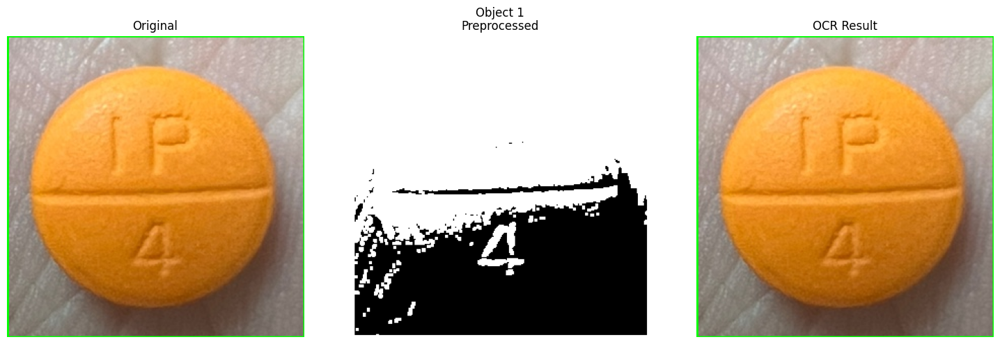


Processing KakaoTalk_20241007_004350293.jpg:

0: 640x480 1 pill, 7.3ms
Speed: 4.1ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 1,|, Confidence: 0.5262283912722441


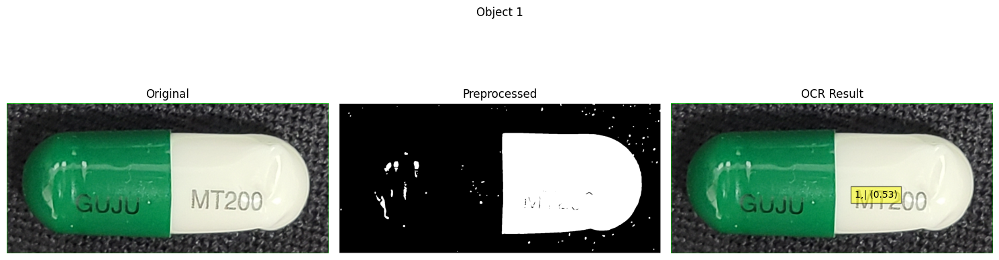


Processing KakaoTalk_20241007_004350293_01.jpg:

0: 640x480 1 pill, 7.3ms
Speed: 3.4ms preprocess, 7.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)


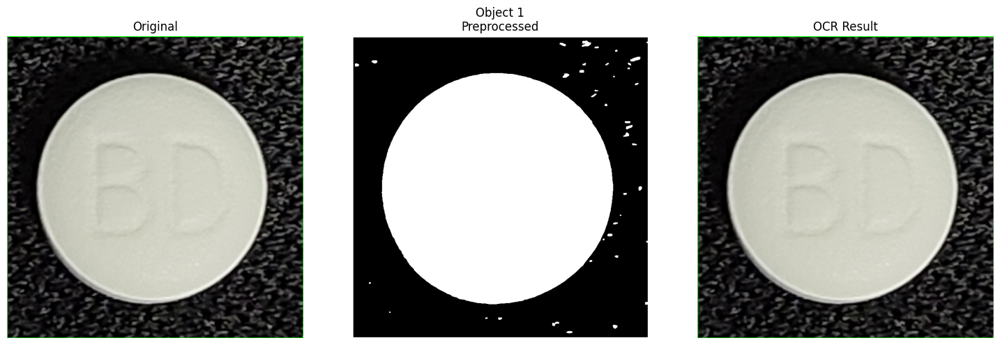


Processing KakaoTalk_20241007_004350293_02.jpg:

0: 640x480 1 pill, 6.6ms
Speed: 3.2ms preprocess, 6.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


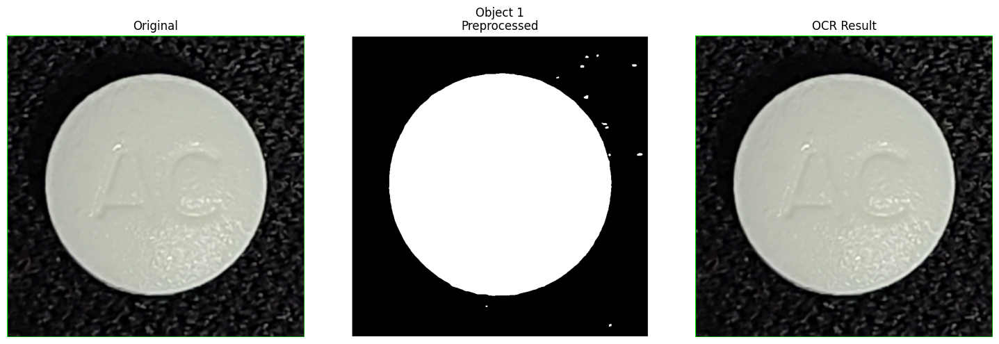


Processing KakaoTalk_20241007_004350293_03.jpg:

0: 640x480 1 pill, 8.4ms
Speed: 4.1ms preprocess, 8.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)


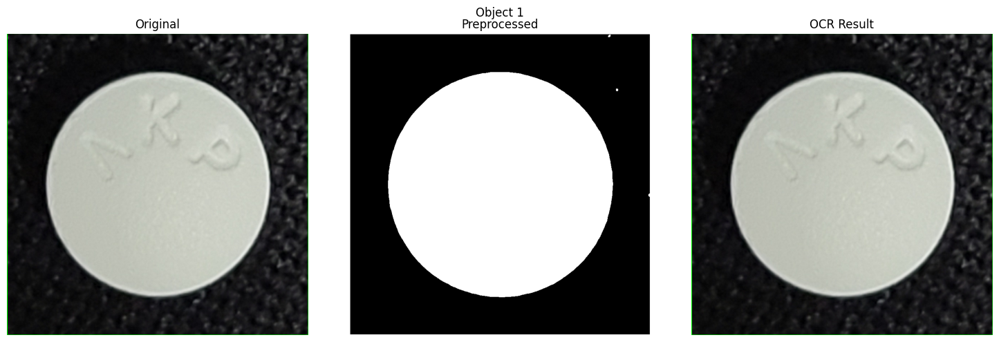


Processing KakaoTalk_20241007_004350293_04.jpg:

0: 640x480 1 pill, 6.7ms
Speed: 3.0ms preprocess, 6.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


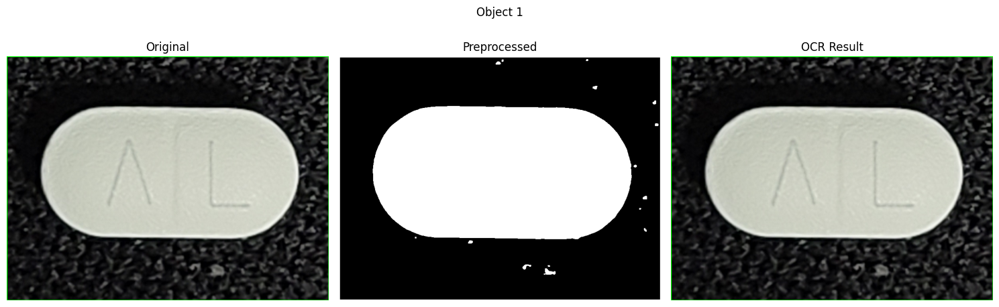


Processing KakaoTalk_20241007_004350293_05.jpg:

0: 640x480 1 pill, 7.5ms
Speed: 3.7ms preprocess, 7.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


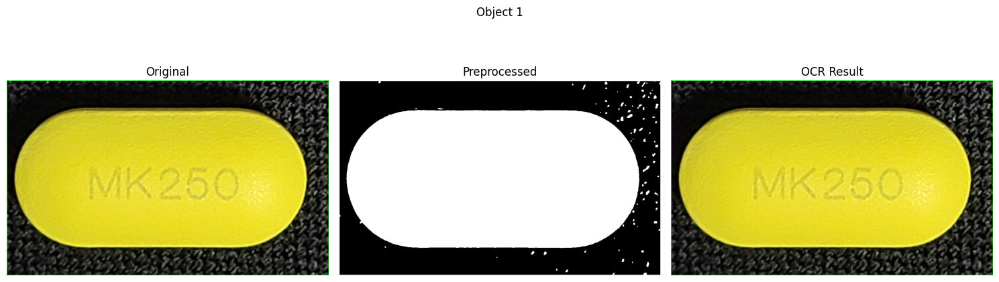


Processing KakaoTalk_20241007_004550650.jpg:

0: 640x480 1 pill, 8.7ms
Speed: 4.1ms preprocess, 8.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)
Detected text: AC, Confidence: 0.5308006677660398


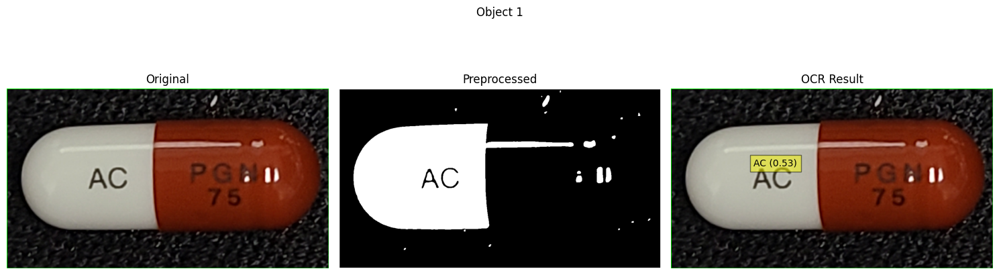


Processing KakaoTalk_20241007_004550650_01.jpg:

0: 640x480 1 pill, 8.3ms
Speed: 4.3ms preprocess, 8.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)


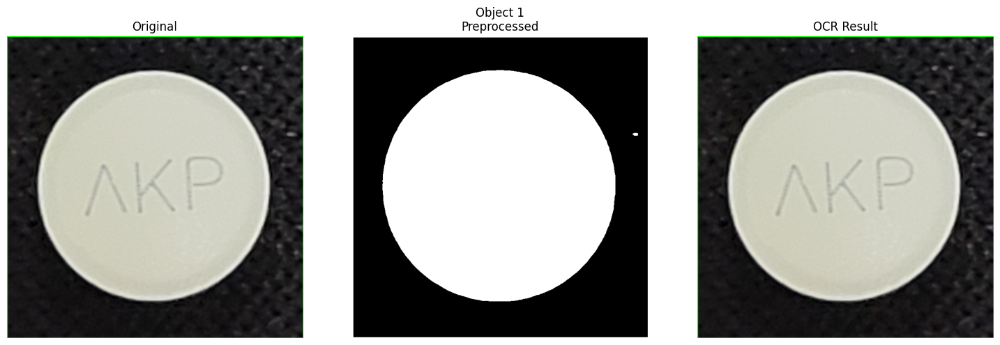


Processing KakaoTalk_20241007_004550650_02.jpg:

0: 640x480 1 pill, 9.3ms
Speed: 3.7ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Detected text: AC, Confidence: 0.9986372430459612


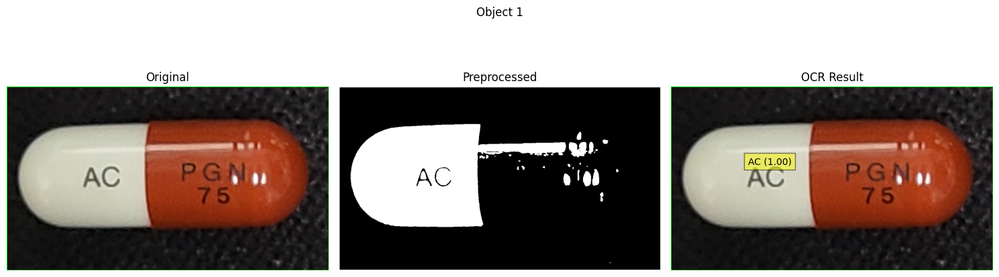


Processing flash1.jpg:

0: 640x480 1 pill, 6.8ms
Speed: 3.5ms preprocess, 6.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)


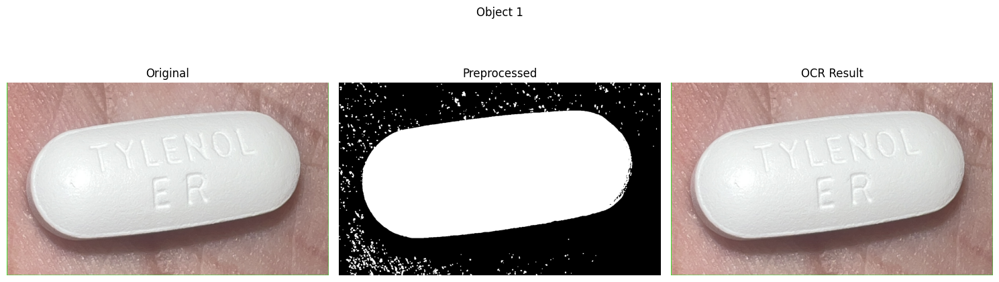


Processing flash2.jpg:

0: 640x480 1 pill, 8.9ms
Speed: 4.1ms preprocess, 8.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)


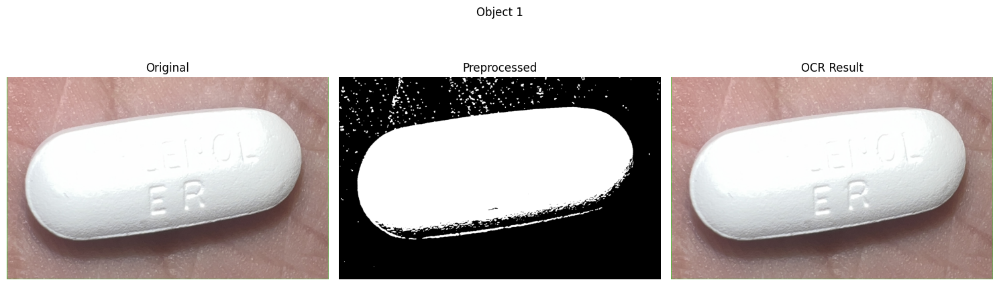


Processing flash3.jpg:

0: 640x480 1 pill, 7.6ms
Speed: 4.1ms preprocess, 7.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Detected text: Lii3, Confidence: 0.07211297750473022
Detected text: 5oteta, Confidence: 0.08622638903825326
Detected text: 4, Confidence: 0.04742128520960254


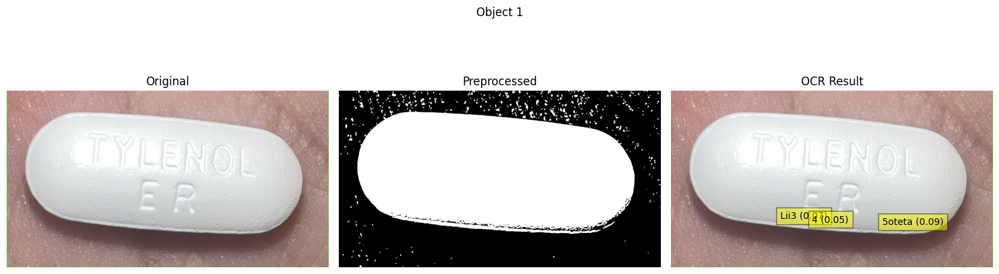


Processing falsh4.jpg:

0: 640x480 1 pill, 6.7ms
Speed: 3.2ms preprocess, 6.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


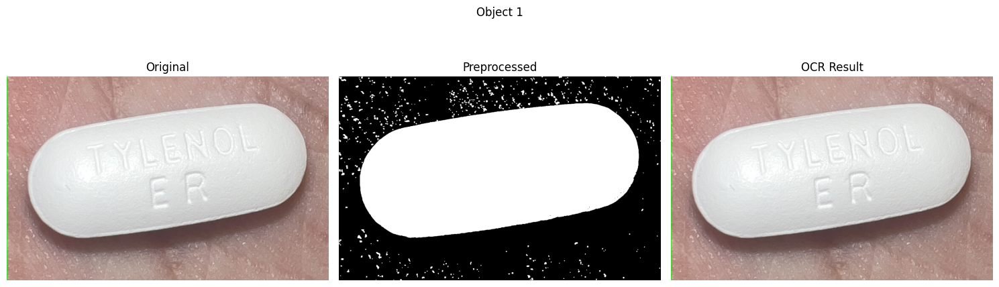


Processing 타이레놀1.jpg:

0: 640x480 3 pills, 6.7ms
Speed: 3.0ms preprocess, 6.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 1, Confidence: 0.9389920383529251
Detected text: 0=, Confidence: 0.02423211586682311


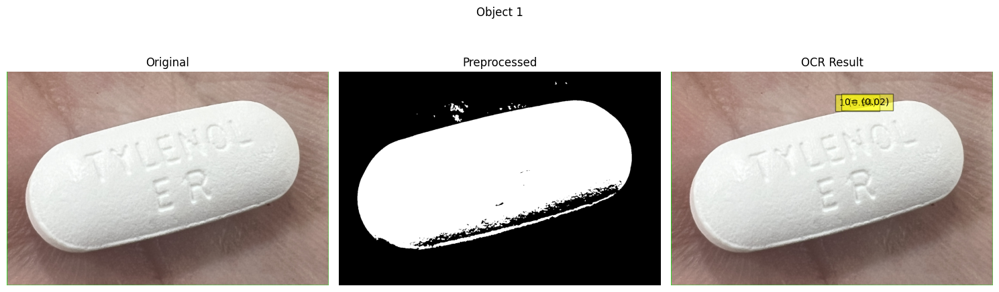

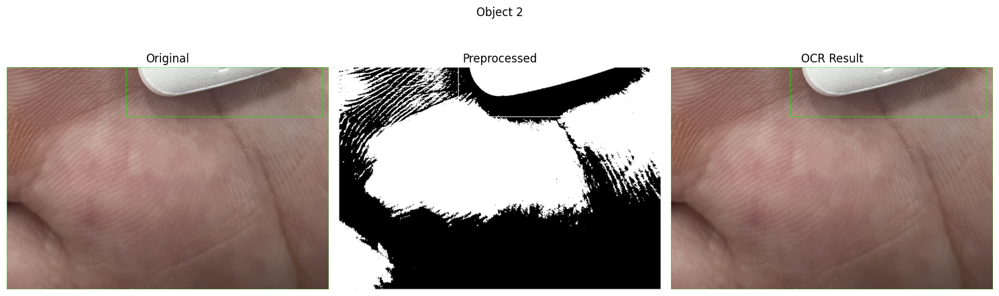

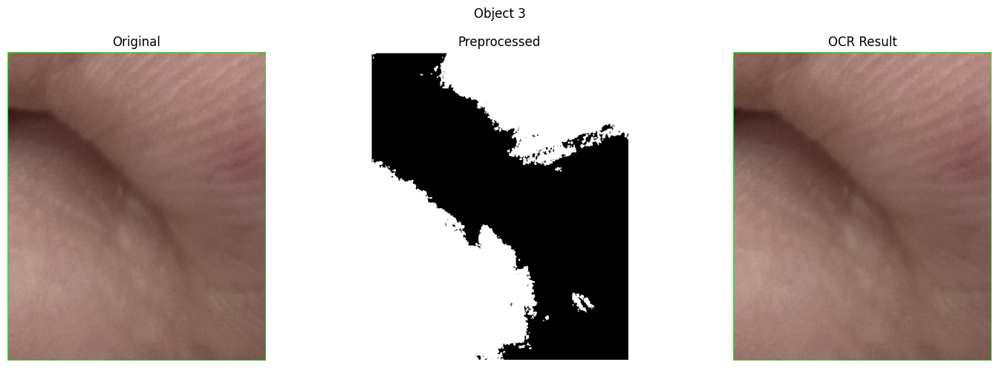


Processing 타이레놀2.jpg:

0: 640x480 2 pills, 7.3ms
Speed: 3.5ms preprocess, 7.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)
Detected text: Sin, Confidence: 0.02282209222388215


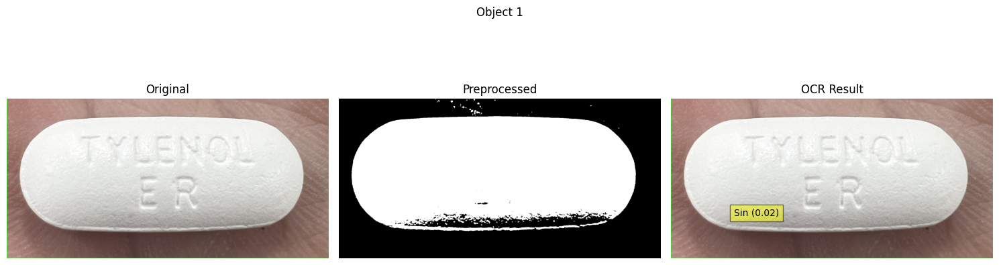

Detected text: J6, Confidence: 0.12207113202173554


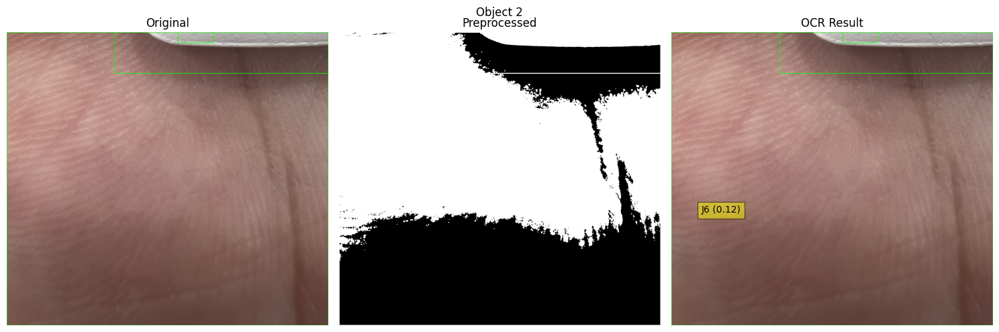


Processing 타이레놀3.jpg:

0: 640x480 2 pills, 7.5ms
Speed: 3.7ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Detected text: Xl, Confidence: 0.1013102871489777
Detected text: K", Confidence: 0.01786007554670199
Detected text: Jo, Confidence: 0.0036441038963305372
Detected text: 360, Confidence: 0.0034684626617455623
Detected text: 4, Confidence: 0.7853600726676291


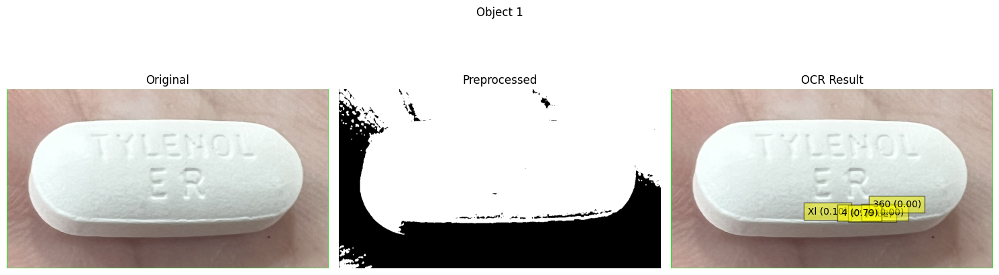

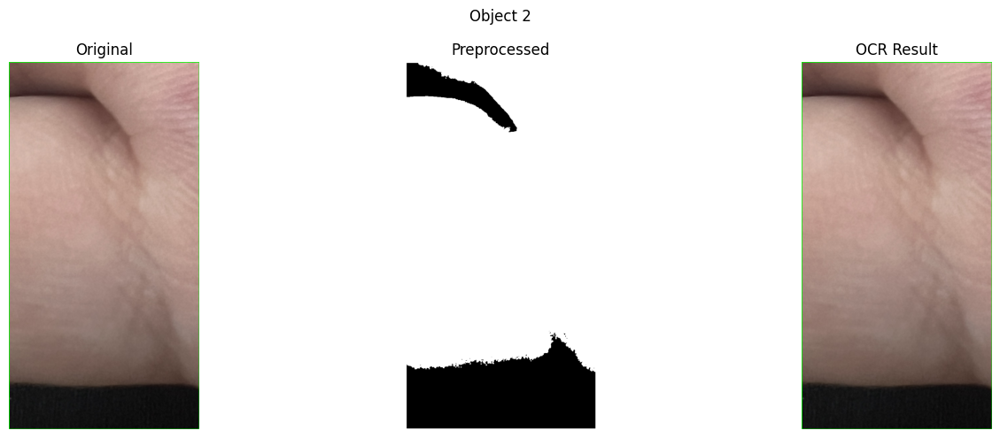


Processing 타이레놀5.jpg:

0: 640x480 3 pills, 7.2ms
Speed: 4.0ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


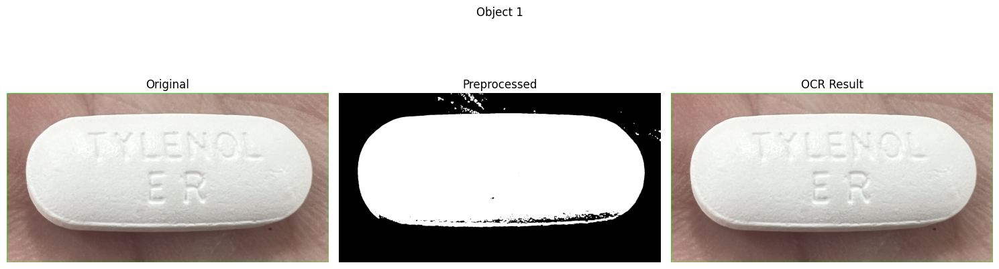

Detected text: v, Confidence: 0.21533509575357712
Detected text: XX, Confidence: 0.07164612732601917
Detected text: 4, Confidence: 0.1248150395278893


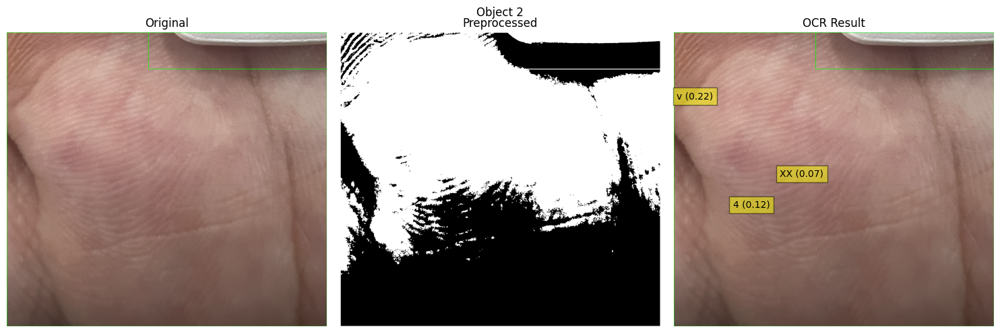

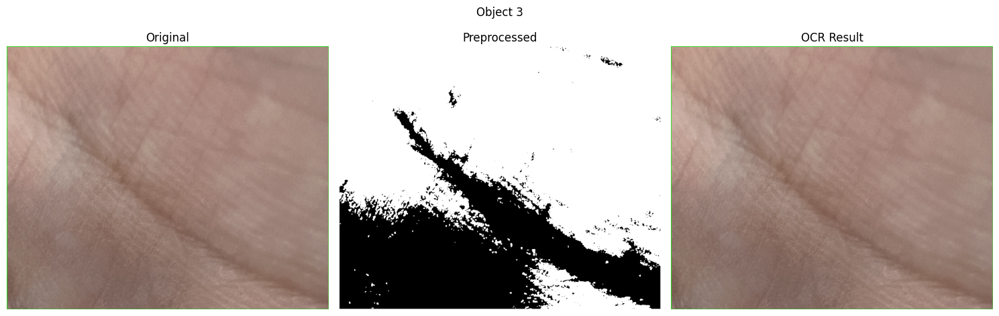


Processing 타이레놀6.jpg:

0: 640x480 2 pills, 6.8ms
Speed: 3.1ms preprocess, 6.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


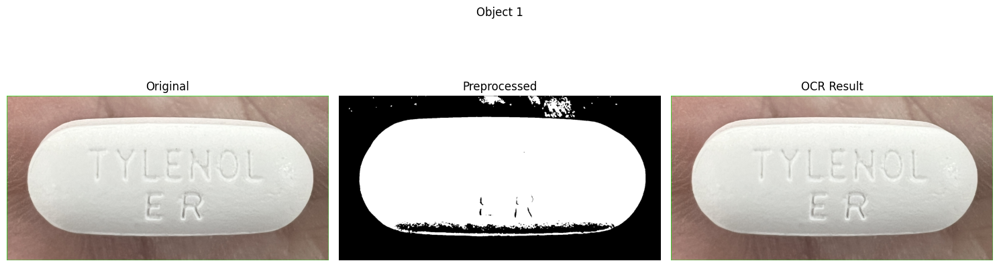

Detected text: ~+07/ ^, Confidence: 0.1945963319354904
Detected text: Uin, Confidence: 0.04921990969562274


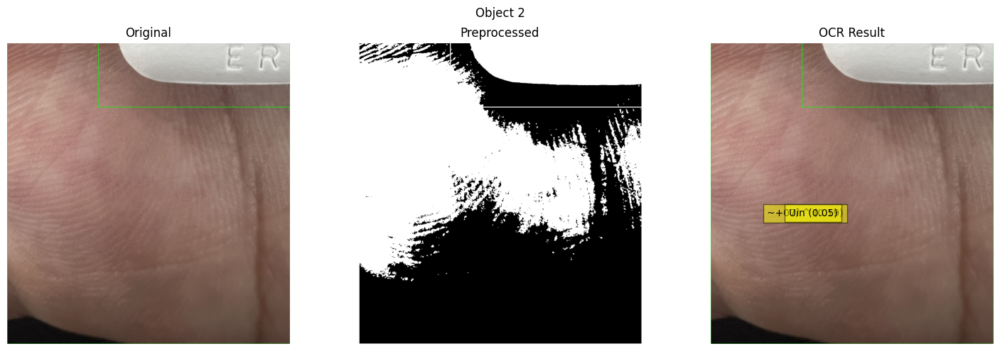


Processing 타이레놀7.jpg:

0: 640x480 2 pills, 10.4ms
Speed: 4.5ms preprocess, 10.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 16dA, Confidence: 0.355859637260437


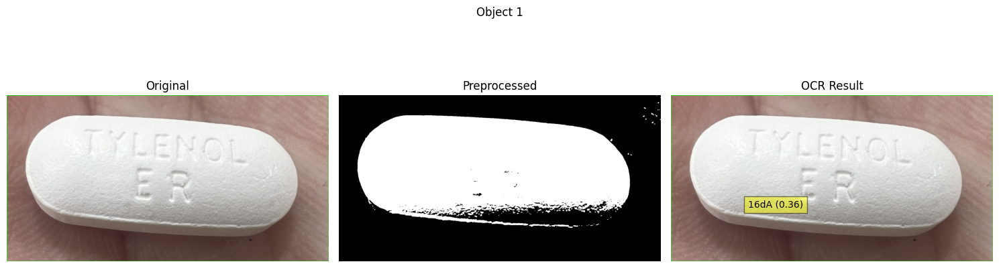

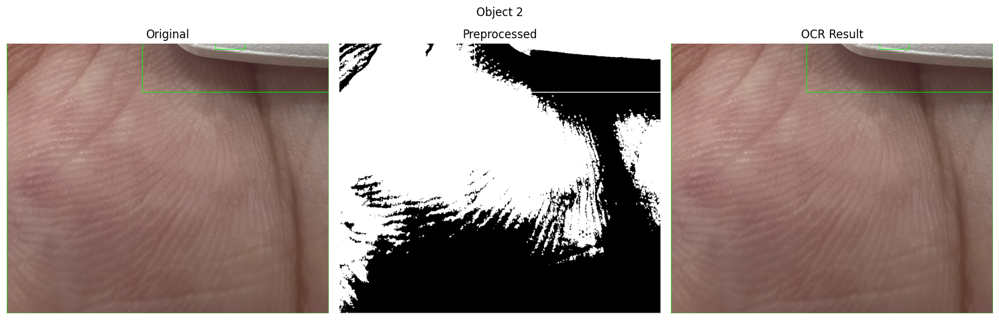


Processing 타이레놀8.jpg:

0: 640x480 2 pills, 6.7ms
Speed: 3.2ms preprocess, 6.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


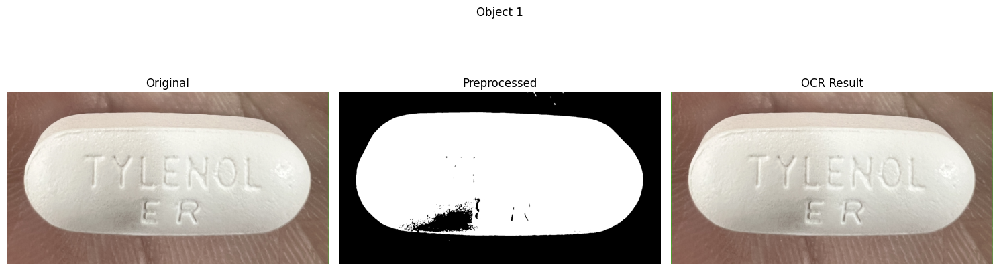

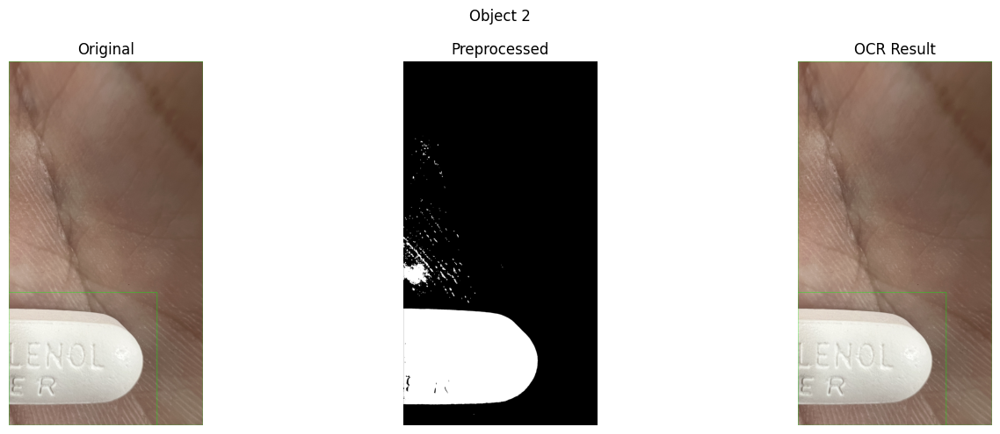


Processing 타이레놀9.jpg:

0: 640x480 3 pills, 7.7ms
Speed: 3.9ms preprocess, 7.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Detected text: Aecot Iu}, Confidence: 0.0029536460628355374
Detected text: EZnise2, Confidence: 0.0023901461391457736


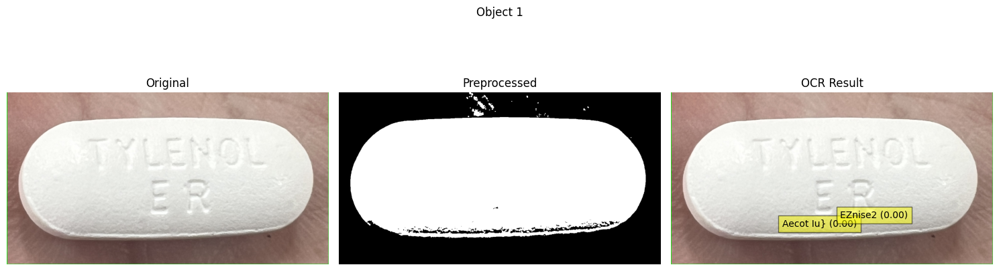

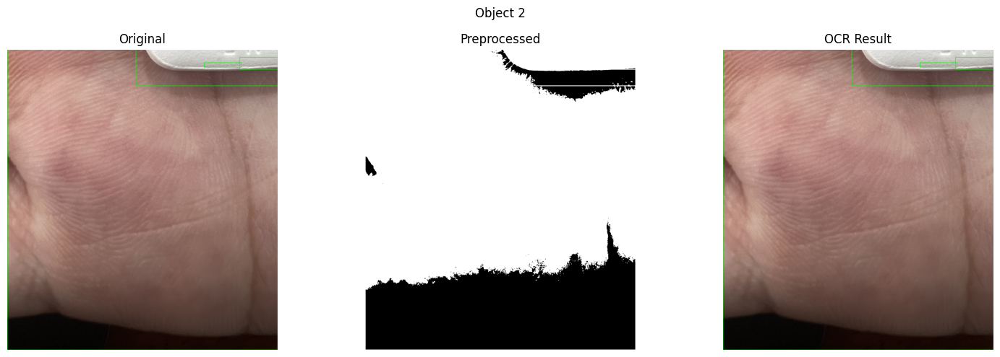

Detected text: Mx, Confidence: 0.041991968589569134


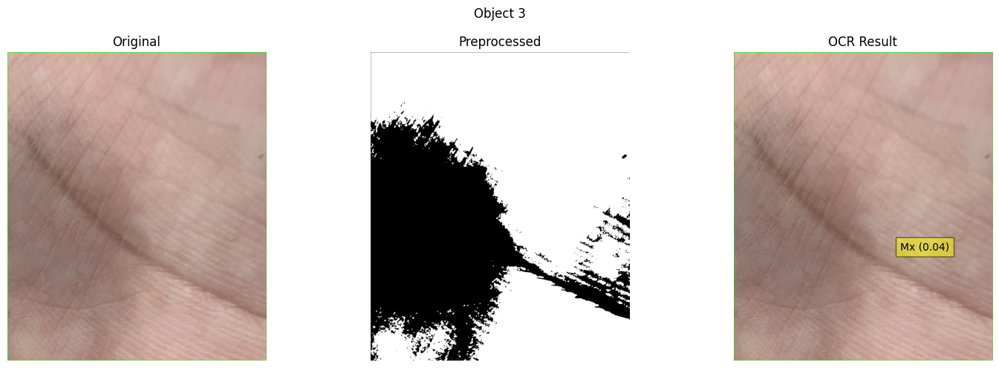


Processing 타이레놀 글자 감지된 거.jpg:

0: 640x480 2 pills, 6.8ms
Speed: 3.1ms preprocess, 6.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


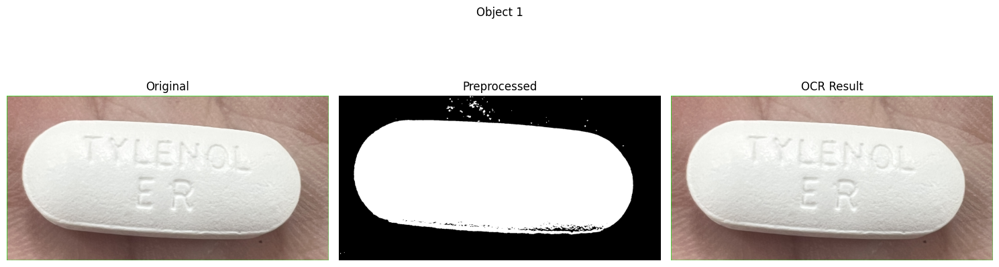

Detected text: Aln _, Confidence: 0.026723625311673074
Detected text: #, Confidence: 0.16056486305616602


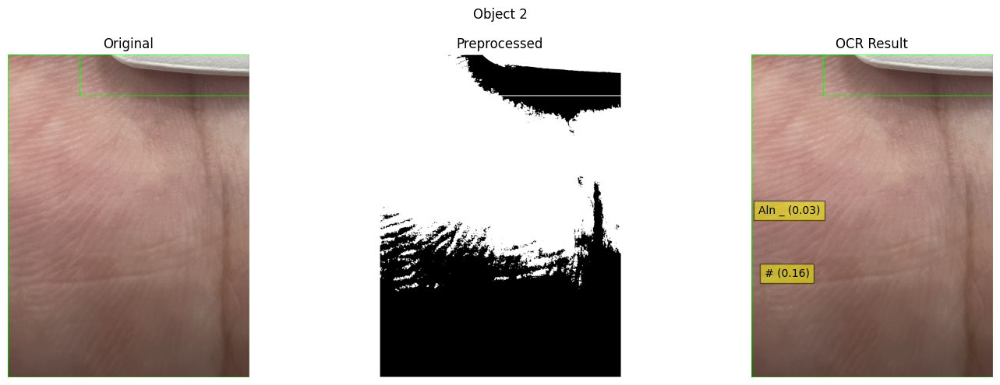


Overall Results:
198301052_010.jpg: 2 text regions detected
200308578_010.jpg: 1 text regions detected
198500049_009.jpg: 1 text regions detected
198500050_005.jpg: 1 text regions detected
11.jpg: 0 text regions detected
image1.jpg: 0 text regions detected
KakaoTalk_20241007_004350293.jpg: 1 text regions detected
KakaoTalk_20241007_004350293_01.jpg: 0 text regions detected
KakaoTalk_20241007_004350293_02.jpg: 0 text regions detected
KakaoTalk_20241007_004350293_03.jpg: 0 text regions detected
KakaoTalk_20241007_004350293_04.jpg: 0 text regions detected
KakaoTalk_20241007_004350293_05.jpg: 0 text regions detected
KakaoTalk_20241007_004550650.jpg: 1 text regions detected
KakaoTalk_20241007_004550650_01.jpg: 0 text regions detected
KakaoTalk_20241007_004550650_02.jpg: 1 text regions detected
flash1.jpg: 0 text regions detected
flash2.jpg: 0 text regions detected
flash3.jpg: 3 text regions detected
falsh4.jpg: 0 text regions detected
타이레놀1.jpg: 2 text regions detected
타이레놀2.jpg:

In [ ]:
# 잘 안나옴
import os
import cv2
import numpy as np
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt

def preprocess_image(image):
    # 회색조 변환
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # 이진화
    _, binary = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    # 노이즈 제거
    blurred = cv2.GaussianBlur(binary, (5, 5), 0)
    # 경계선 검출
    edges = cv2.Canny(blurred, 100, 200)
    # 형태학적 변환
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    dilated = cv2.dilate(binary, kernel, iterations=1)
    return dilated

def detect_and_recognize(image_path, yolo_model, ocr_reader):
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return []

    # YOLO를 사용한 객체 검출
    results = yolo_model(image)

    detected_texts = []

    # 검출된 객체의 바운딩 박스 처리
    for i, box in enumerate(results[0].boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0])

        # 바운딩 박스 그리기
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # 박스화된 부분 잘라내기
        cropped_image = image[y1:y2, x1:x2]

        # 이미지 전처리
        preprocessed = preprocess_image(cropped_image)

        # OCR 수행
        ocr_result = ocr_reader.readtext(preprocessed)

        for (bbox, text, prob) in ocr_result:
            detected_texts.append((text, prob))
            print(f"Detected text: {text}, Confidence: {prob}")

        # 결과 시각화
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"Object {i+1}")

        # 원본 이미지
        axes[0].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original")
        axes[0].axis('off')

        # 전처리된 이미지
        axes[1].imshow(preprocessed, cmap='gray')
        axes[1].set_title("Preprocessed")
        axes[1].axis('off')

        # OCR 결과
        axes[2].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[2].set_title("OCR Result")
        axes[2].axis('off')
        for (bbox, text, prob) in ocr_result:
            (top_left, top_right, bottom_right, bottom_left) = bbox
            top_left = tuple(map(int, top_left))
            bottom_right = tuple(map(int, bottom_right))
            cv2.rectangle(cropped_image, top_left, bottom_right, (0, 255, 0), 2)
            axes[2].text(top_left[0], top_left[1], f"{text} ({prob:.2f})",
                         bbox=dict(facecolor='yellow', alpha=0.5))

        plt.tight_layout()
        plt.show()

    return detected_texts

# 메인 실행 코드
if __name__ == "__main__":
    # YOLO 모델 로드
    yolo_model = YOLO('/content/drive/MyDrive/yolo_checkpoints/pill/weights/best.pt')

    # EasyOCR 리더 초기화
    # ocr_reader = easyocr.Reader(
    #     ['en'],
    #     model_storage_directory='/content/drive/MyDrive/EASY/model2',
    #     recog_network='english_g2',
    # )

    ocr_reader = easyocr.Reader(
        ['en'])

    # 이미지가 있는 폴더 경로
    folder_path = '/content/drive/MyDrive/pill_images'

    # 결과를 저장할 딕셔너리
    results = {}

    # 폴더 내의 모든 이미지 파일에 대해 처리
    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            print(f"\nProcessing {filename}:")
            detected_texts = detect_and_recognize(image_path, yolo_model, ocr_reader)
            results[filename] = detected_texts

    # 전체 결과 요약
    print("\nOverall Results:")
    for filename, texts in results.items():
        print(f"{filename}: {len(texts)} text regions detected")

    # 평균 신뢰도 계산
    all_confidences = [prob for texts in results.values() for _, prob in texts]
    avg_confidence = np.mean(all_confidences) if all_confidences else 0
    print(f"\nAverage confidence across all detections: {avg_confidence:.4f}")


Processing KakaoTalk_20241009_134400839.jpg:

0: 640x480 1 pill, 8.5ms
Speed: 3.1ms preprocess, 8.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 4, Confidence: 0.2638392005028436


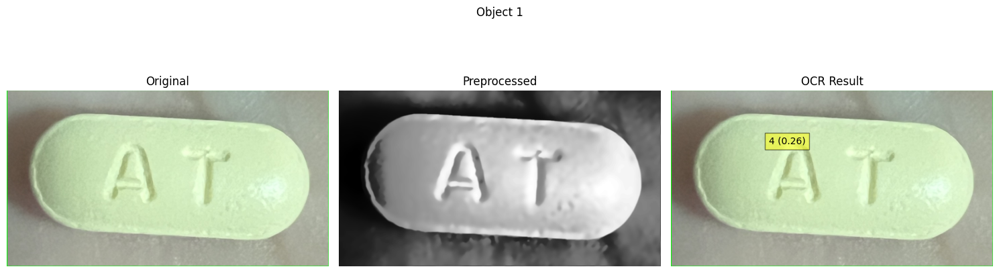


Processing KakaoTalk_20241009_134400839_07.jpg:

0: 640x480 3 pills, 7.5ms
Speed: 3.6ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 90, Confidence: 0.5908776007486862


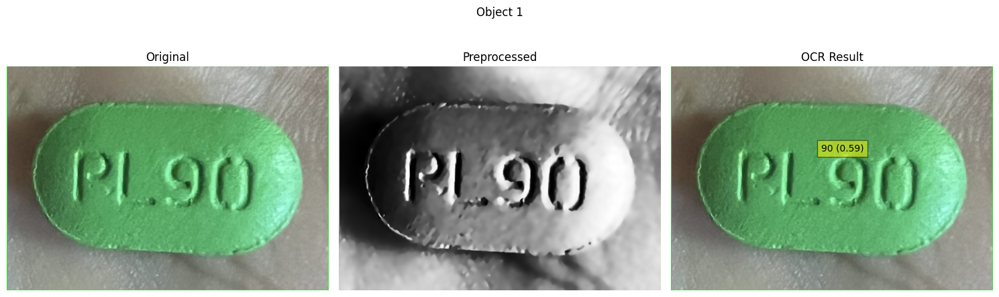

Detected text: :tx, Confidence: 0.16017122966083164


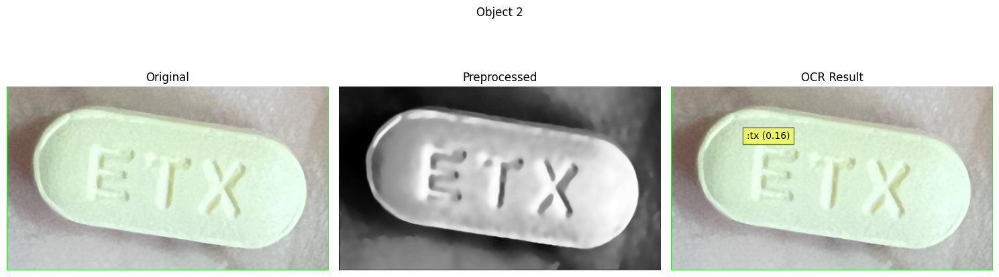

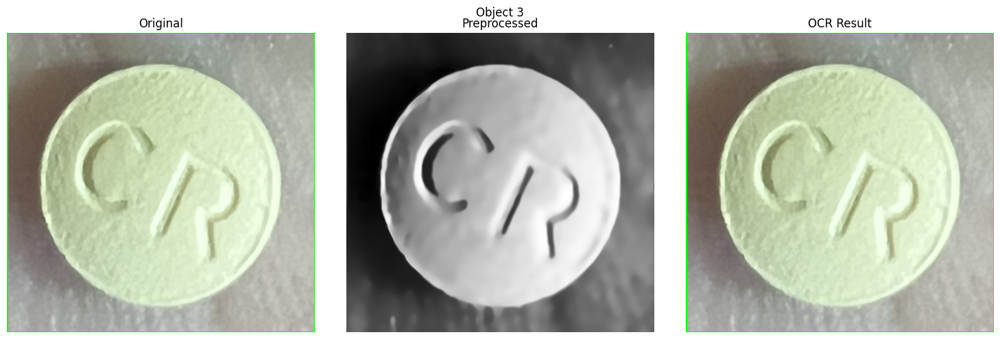


Processing KakaoTalk_20241009_134400839_05.jpg:

0: 640x480 1 pill, 7.4ms
Speed: 3.1ms preprocess, 7.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)
Detected text: CR, Confidence: 0.3494472639711591


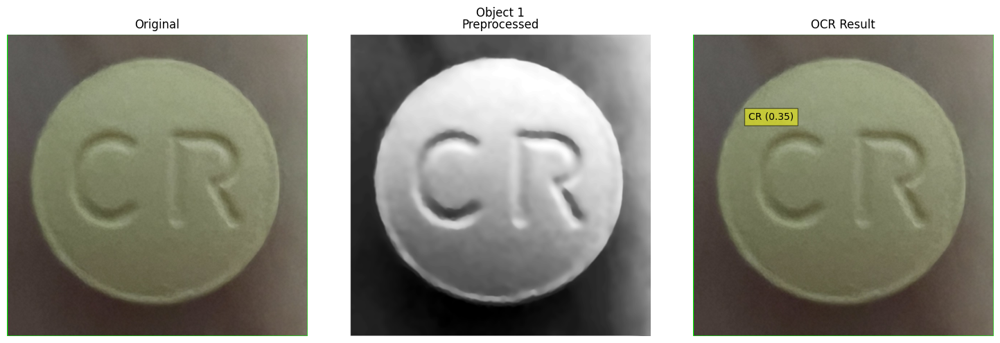


Processing KakaoTalk_20241009_134400839_06.jpg:

0: 640x480 3 pills, 9.4ms
Speed: 4.0ms preprocess, 9.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Detected text: L.90, Confidence: 0.5568617582321167


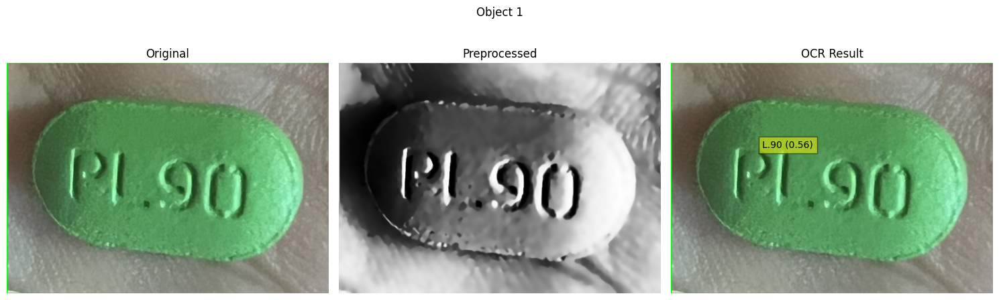

Detected text: ET, Confidence: 0.2401168650020502


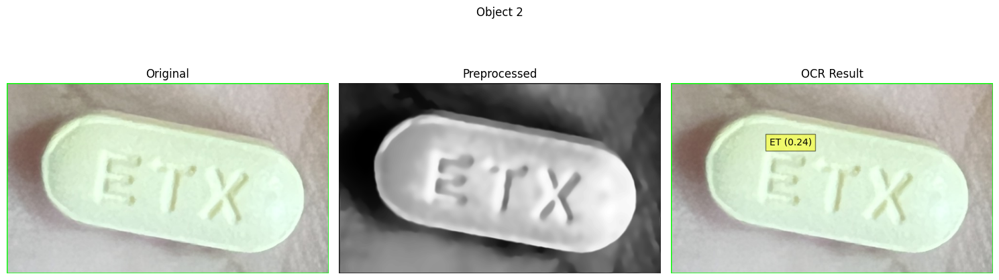

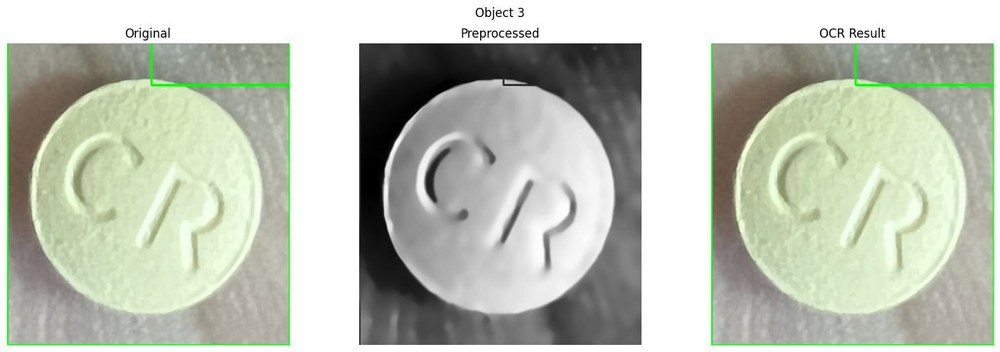


Processing KakaoTalk_20241009_134400839_03.jpg:

0: 640x480 1 pill, 6.9ms
Speed: 3.3ms preprocess, 6.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 4 T, Confidence: 0.4357617497444153


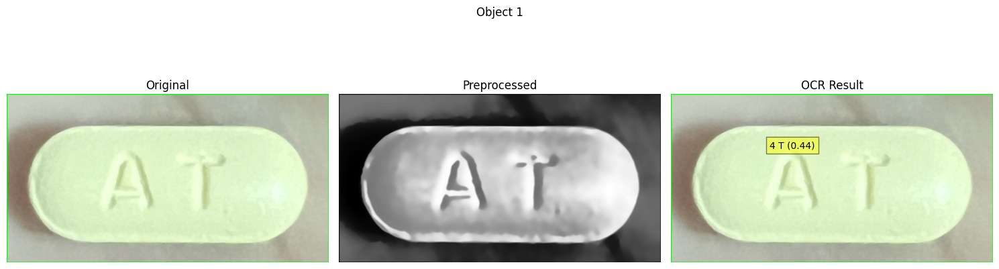


Processing KakaoTalk_20241009_134400839_04.jpg:

0: 640x480 1 pill, 7.0ms
Speed: 3.4ms preprocess, 7.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)
Detected text: CR, Confidence: 0.9807794563310455


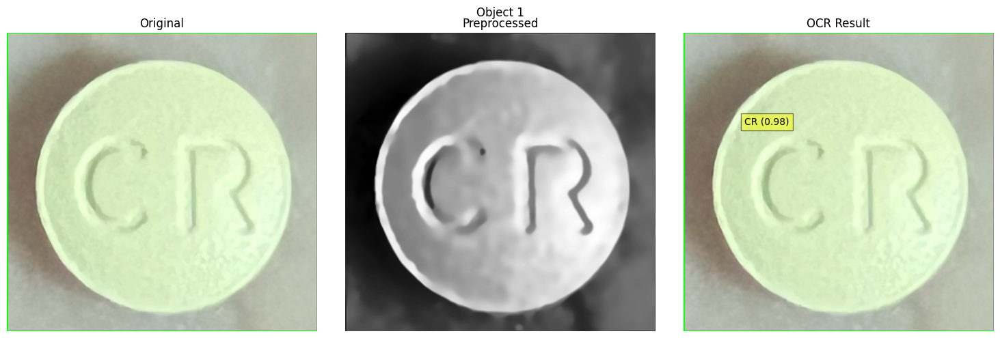


Processing KakaoTalk_20241009_134400839_02.jpg:

0: 640x480 1 pill, 7.0ms
Speed: 3.2ms preprocess, 7.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 9), Confidence: 0.5604024873627335


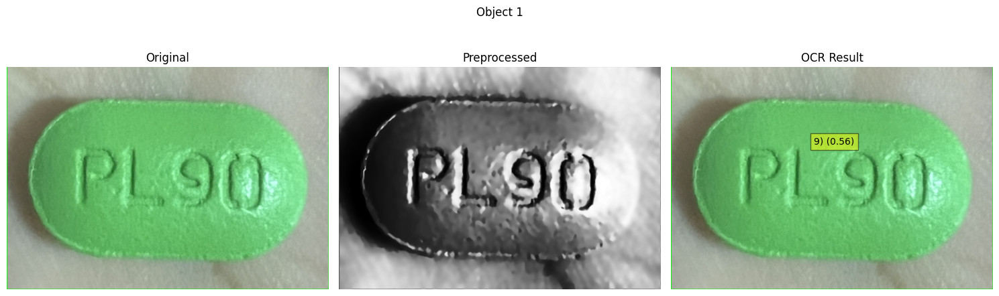


Processing KakaoTalk_20241009_134400839_01.jpg:

0: 640x480 1 pill, 8.0ms
Speed: 3.2ms preprocess, 8.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Detected text: PL,9(), Confidence: 0.2924603798316186


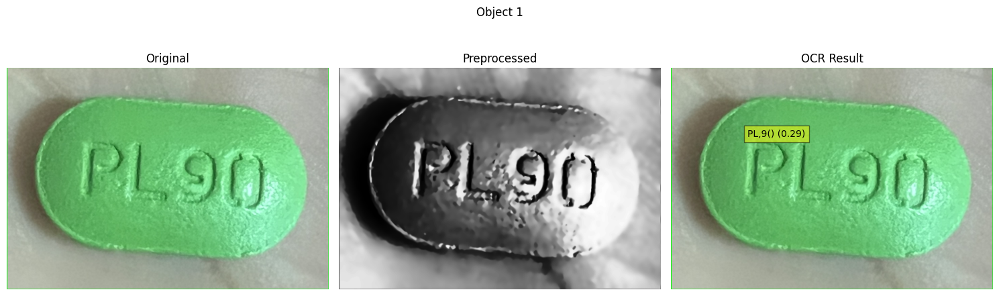


Overall Results:
KakaoTalk_20241009_134400839.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_07.jpg: 2 text regions detected
KakaoTalk_20241009_134400839_05.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_06.jpg: 2 text regions detected
KakaoTalk_20241009_134400839_03.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_04.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_02.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_01.jpg: 1 text regions detected

Average confidence across all detections: 0.4431


In [ ]:
## 전처리 부분 수정
import os
import cv2
import numpy as np
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

def mtjin_bgr2gray(bgr_img):
    b = bgr_img[:, :, 0]
    g = bgr_img[:, :, 1]
    r = bgr_img[:, :, 2]
    result = ((0.299 * r) + (0.587 * g) + (0.114 * b))
    return result.astype(np.uint8)

def histogram_equalization(img):
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return cv2.equalizeHist(img)

def rm_noise(img):
    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    return cv2.fastNlMeansDenoisingColored(img, None, 15, 15, 5, 10)

def preprocess_image(image):
    # 그레이스케일 변환
    gray = mtjin_bgr2gray(image)

    # 히스토그램 평활화
    equalized = histogram_equalization(gray)

    # 노이즈 제거 (여러 번 적용)
    denoised = rm_noise(equalized)
    for _ in range(3):  # 3번 추가 적용
        denoised = rm_noise(denoised)

    # 결과를 그레이스케일로 변환
    final = cv2.cvtColor(denoised, cv2.COLOR_BGR2GRAY)

    return final

def visualize_preprocessing(image):
    original = image.copy()
    preprocessed = preprocess_image(image)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    ax1.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image')
    ax1.axis('off')

    ax2.imshow(preprocessed, cmap='gray')
    ax2.set_title('Preprocessed Image')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

def detect_and_recognize(image_path, yolo_model, ocr_reader):
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return []

    # YOLO를 사용한 객체 검출
    results = yolo_model(image)

    detected_texts = []

    # 검출된 객체의 바운딩 박스 처리
    for i, box in enumerate(results[0].boxes):
        x1, y1, x2, y2 = map(int, box.xyxy[0])

        # 바운딩 박스 그리기
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # 박스화된 부분 잘라내기
        cropped_image = image[y1:y2, x1:x2]

        # 이미지 전처리
        preprocessed = preprocess_image(cropped_image)

        # OCR 수행
        ocr_result = ocr_reader.readtext(preprocessed)

        for (bbox, text, prob) in ocr_result:
            detected_texts.append((text, prob))
            print(f"Detected text: {text}, Confidence: {prob}")

        # 결과 시각화
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"Object {i+1}")

        # 원본 이미지
        axes[0].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original")
        axes[0].axis('off')

        # 전처리된 이미지
        axes[1].imshow(preprocessed, cmap='gray')
        axes[1].set_title("Preprocessed")
        axes[1].axis('off')

        # OCR 결과
        axes[2].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[2].set_title("OCR Result")
        axes[2].axis('off')
        for (bbox, text, prob) in ocr_result:
            (top_left, top_right, bottom_right, bottom_left) = bbox
            top_left = tuple(map(int, top_left))
            bottom_right = tuple(map(int, bottom_right))
            cv2.rectangle(cropped_image, top_left, bottom_right, (0, 255, 0), 2)
            axes[2].text(top_left[0], top_left[1], f"{text} ({prob:.2f})",
                         bbox=dict(facecolor='yellow', alpha=0.5))

        plt.tight_layout()
        plt.show()

    return detected_texts

# 메인 실행 코드
if __name__ == "__main__":
    # YOLO 모델 로드
    yolo_model = YOLO('/content/drive/MyDrive/yolo_checkpoints/pill/weights/best.pt')

    # EasyOCR 리더 초기화
    ocr_reader = easyocr.Reader(
        ['en'],
        model_storage_directory='/content/drive/MyDrive/EASY/model2',
        recog_network='english_g2',
    )

    # ocr_reader = easyocr.Reader(
    #     ['en'])

    # 이미지가 있는 폴더 경로
    folder_path = '/content/drive/MyDrive/pillimgtest/손바닥'

    # 결과를 저장할 딕셔너리
    results = {}

    # 폴더 내의 모든 이미지 파일에 대해 처리
    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            print(f"\nProcessing {filename}:")
            detected_texts = detect_and_recognize(image_path, yolo_model, ocr_reader)
            results[filename] = detected_texts

    # 전체 결과 요약
    print("\nOverall Results:")
    for filename, texts in results.items():
        print(f"{filename}: {len(texts)} text regions detected")

    # 평균 신뢰도 계산
    all_confidences = [prob for texts in results.values() for _, prob in texts]
    avg_confidence = np.mean(all_confidences) if all_confidences else 0
    print(f"\nAverage confidence across all detections: {avg_confidence:.4f}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.

Processing 마이칼디정.jpg:

0: 416x640 2 pills, 92.3ms
Speed: 11.8ms preprocess, 92.3ms inference, 849.0ms postprocess per image at shape (1, 3, 416, 640)
Detected text: 0, Confidence: 0.6362504344906625


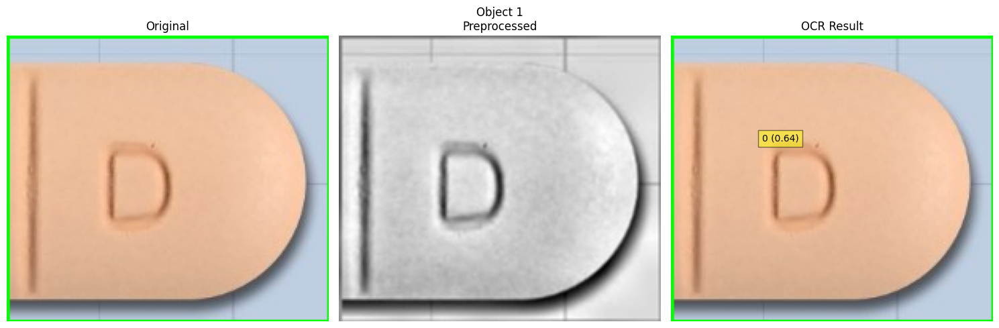

Detected text: MM, Confidence: 0.9999930036303156


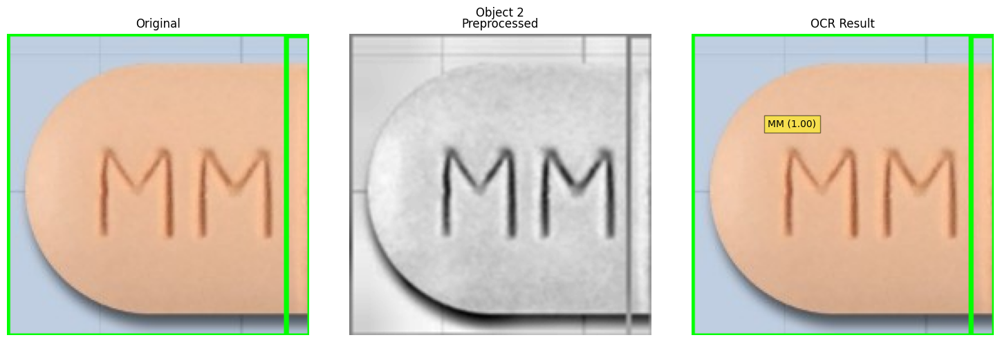


Processing 카이로정.jpg:

0: 352x640 2 pills, 36.2ms
Speed: 1.6ms preprocess, 36.2ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Detected text: T3, Confidence: 0.9823757710815949


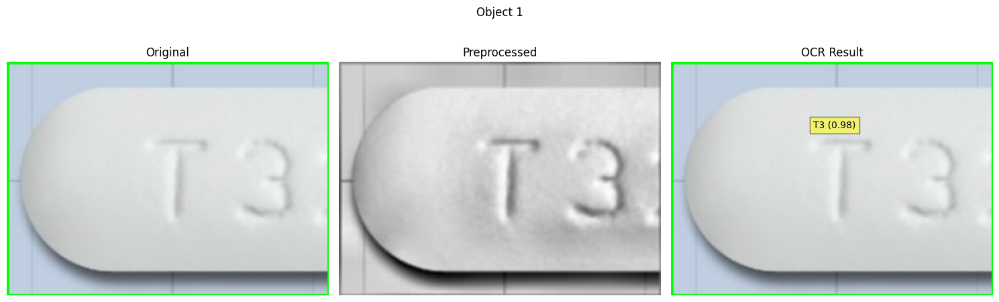

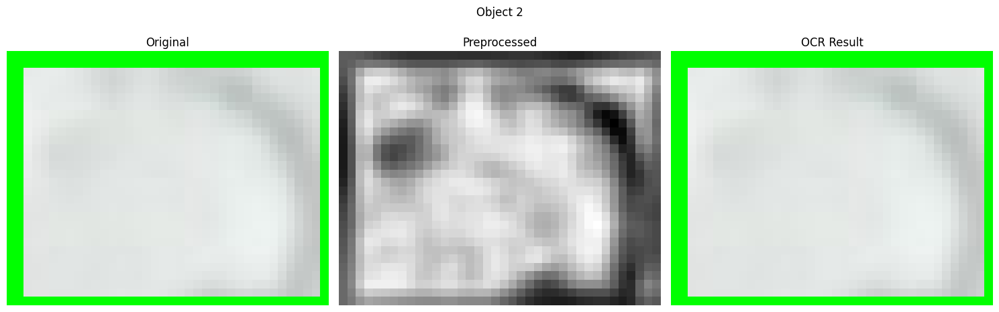


Processing 아스노캡슐.jpg:

0: 256x640 2 pills, 34.9ms
Speed: 1.4ms preprocess, 34.9ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 640)
Detected text: KDC, Confidence: 0.9999624901883519


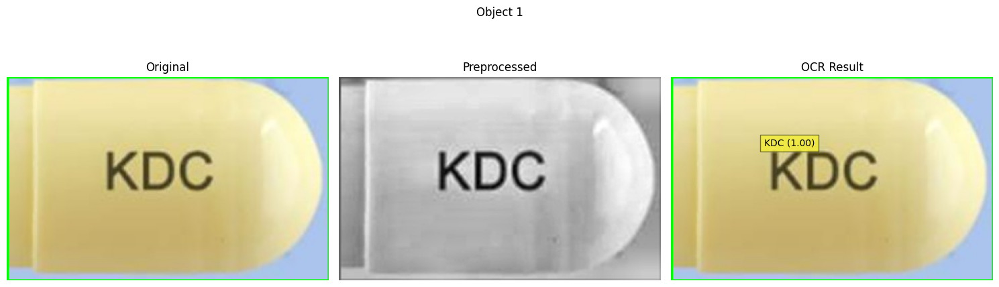

Detected text: ASN, Confidence: 0.9999959392956953
Detected text: KD, Confidence: 0.9999356002228548


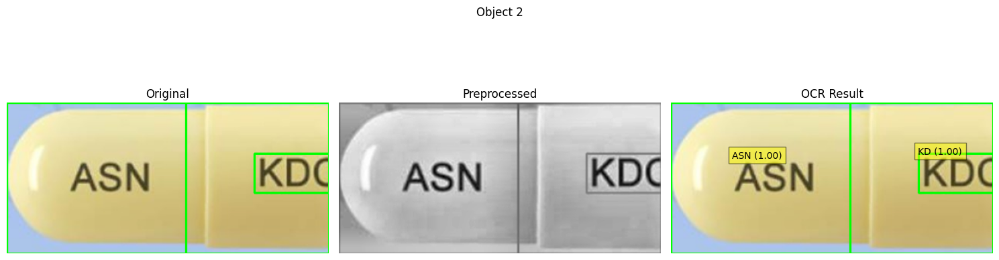


Processing 덴타칸캡슐.jpg:

0: 256x640 1 pill, 8.1ms
Speed: 1.9ms preprocess, 8.1ms inference, 1.8ms postprocess per image at shape (1, 3, 256, 640)
Detected text: EMN, Confidence: 0.9997793486592725


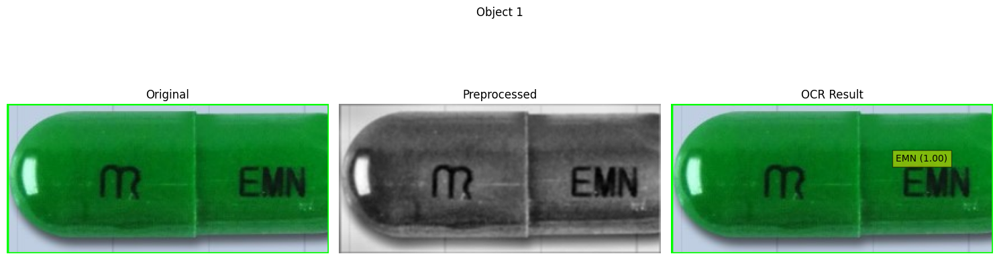


Processing 다비움정.jpg:

0: 384x640 1 pill, 36.4ms
Speed: 1.8ms preprocess, 36.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Detected text: 9, Confidence: 0.5985636362031279


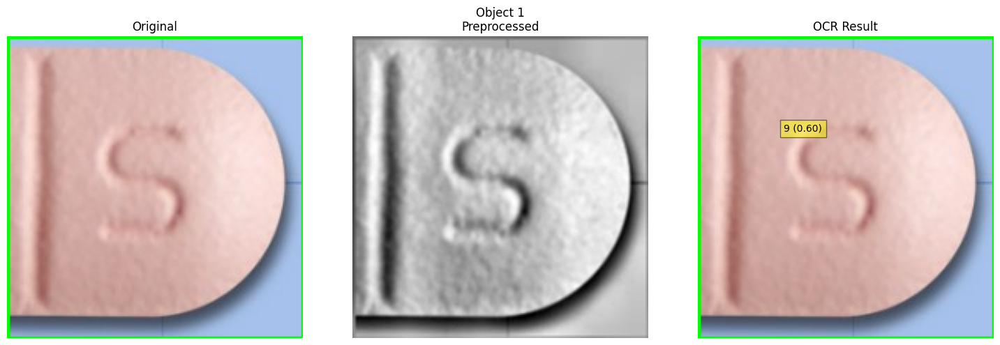


Processing 메가600정.jpg:

0: 352x640 2 pills, 9.3ms
Speed: 1.9ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)
Detected text: 1, Confidence: 0.2929822009408021


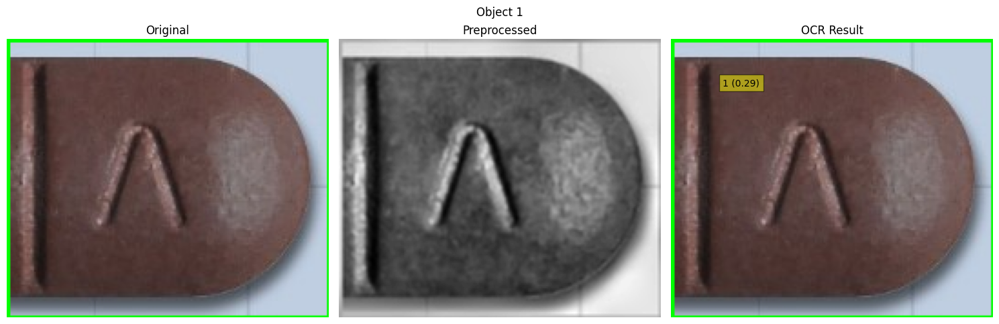

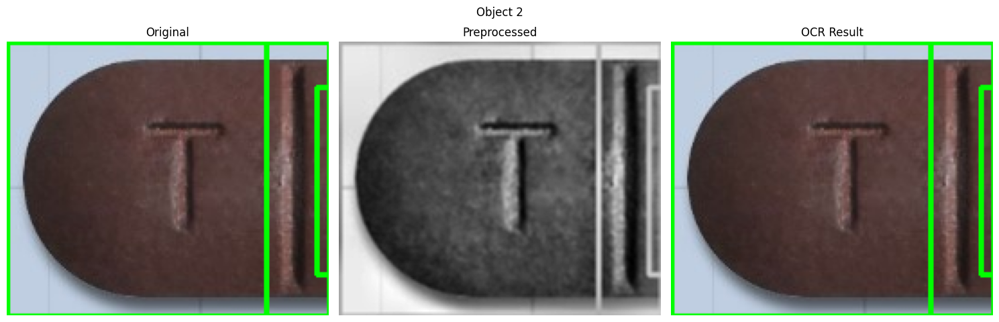


Processing 멜아웃정.jpg:

0: 640x640 (no detections), 9.3ms
Speed: 3.1ms preprocess, 9.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

Processing 베스타제당의정.jpg:

0: 640x640 1 pill, 9.2ms
Speed: 3.8ms preprocess, 9.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


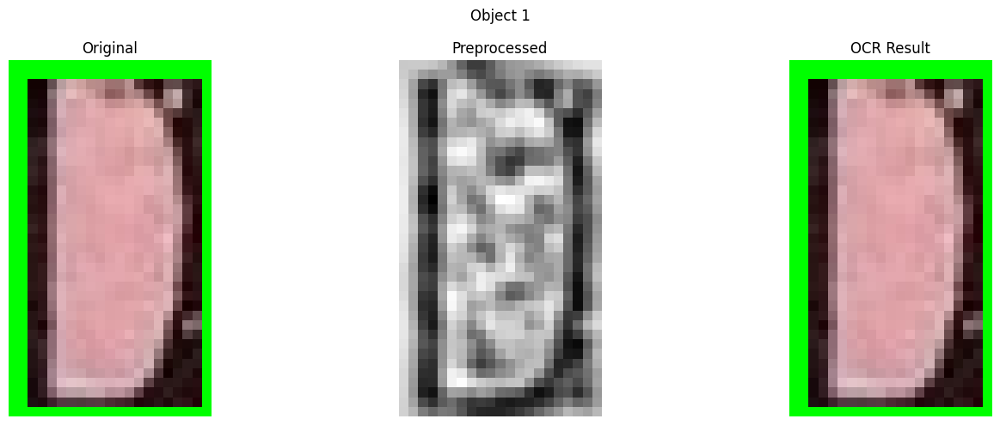


Processing 벤포렉스캡슐.jpg:

0: 224x640 2 pills, 34.5ms
Speed: 1.3ms preprocess, 34.5ms inference, 1.2ms postprocess per image at shape (1, 3, 224, 640)
Detected text: BFRX, Confidence: 0.99996417760849


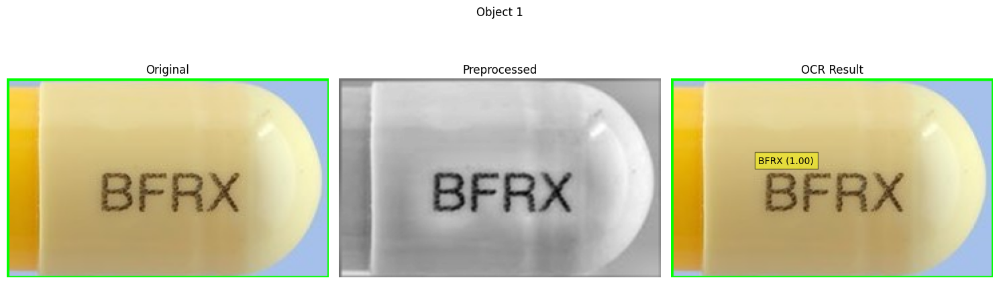

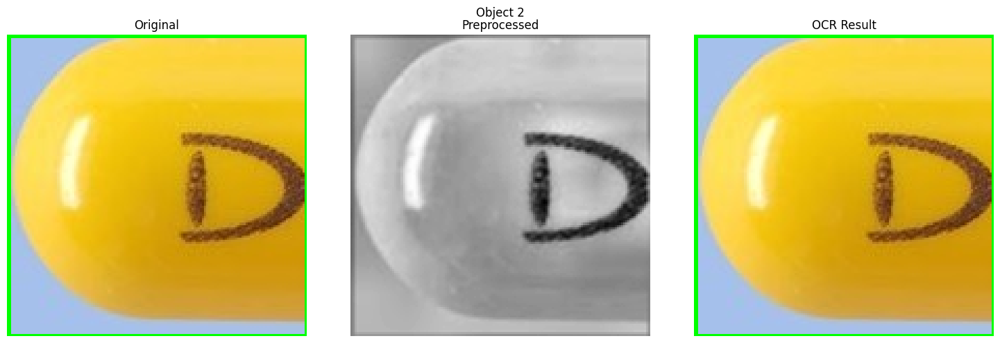


Overall Results:
마이칼디정.jpg: 2 text regions detected
카이로정.jpg: 1 text regions detected
아스노캡슐.jpg: 3 text regions detected
덴타칸캡슐.jpg: 1 text regions detected
다비움정.jpg: 1 text regions detected
메가600정.jpg: 1 text regions detected
멜아웃정.jpg: 0 text regions detected
베스타제당의정.jpg: 0 text regions detected
벤포렉스캡슐.jpg: 1 text regions detected

Average confidence across all detections: 0.8510


In [ ]:
## 10/08 경 가장 잘 나옴
## 이걸로
## 필요한 라이브러리 import
import os
import cv2
import numpy as np
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import re

# BGR 이미지를 그레이스케일로 변환하는 함수
def mtjin_bgr2gray(bgr_img):
    # BGR 채널 분리
    b = bgr_img[:, :, 0]
    g = bgr_img[:, :, 1]
    r = bgr_img[:, :, 2]
    # 그레이스케일 변환 공식 적용 (BT.601 표준)
    result = ((0.299 * r) + (0.587 * g) + (0.114 * b))
    return result.astype(np.uint8)

# 히스토그램 평활화 함수
def histogram_equalization(img):
    # 입력 이미지가 컬러인 경우 그레이스케일로 변환
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # 히스토그램 평활화 적용
    return cv2.equalizeHist(img)

# 노이즈 제거 함수
def rm_noise(img):
    # 입력 이미지가 그레이스케일인 경우 컬러로 변환
    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    # Non-local Means Denoising 알고리즘 적용
    # 파라미터: None(템플릿 윈도우 크기), 15(검색 윈도우 크기), 15(필터 강도), 5(컬러 이미지용), 10(템플릿 윈도우 크기)
    return cv2.fastNlMeansDenoisingColored(img, None, 15, 15, 5, 10)

# 이미지 전처리 함수
def preprocess_image(image):
    # 그레이스케일 변환
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # CLAHE 적용
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    enhanced = clahe.apply(gray)


    # 가우시안 블러로 노이즈 제거
    denoised = cv2.GaussianBlur(enhanced, (3,3), 0)


    # 언샤프 마스크로 엣지 강화
    gaussian_3 = cv2.GaussianBlur(denoised, (3,3), 2.0)
    unsharp_image = cv2.addWeighted(denoised, 1.5, gaussian_3, -0.5, 0)

    return unsharp_image

# 해볼만한 전처리 Erode (침식)
# Dilation (팽창)
# clahe 히스토그램 평활화 개선 방법



# 전처리 과정을 시각화하는 함수
def visualize_preprocessing(image):
    original = image.copy()
    preprocessed = preprocess_image(image)

    # 원본 이미지와 전처리된 이미지를 나란히 표시
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    ax1.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image')
    ax1.axis('off')

    ax2.imshow(preprocessed, cmap='gray')
    ax2.set_title('Preprocessed Image')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

# 객체 검출 및 텍스트 인식 함수
def detect_and_recognize(image_path, yolo_model, ocr_reader):
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return []

    # YOLO 모델을 사용하여 객체(알약) 검출
    results = yolo_model(image)
    detected_texts = []

    # 검출된 각 객체에 대해 처리
    for i, box in enumerate(results[0].boxes):
        # 바운딩 박스 좌표 추출
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        # 원본 이미지에 바운딩 박스 그리기
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        # 검출된 객체 영역 크롭
        cropped_image = image[y1:y2, x1:x2]
        # 크롭된 이미지 전처리
        preprocessed = preprocess_image(cropped_image)

        # OCR 수행
        ocr_result = ocr_reader.readtext(
        preprocessed,
        detail=1,
        paragraph=False,
        min_size=20,
        contrast_ths=0.15,
        adjust_contrast=0.4,
        text_threshold=0.6,
        low_text=0.4,
        link_threshold=0.4,
        mag_ratio=1.2,
        allowlist='ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789'
)

        # 결과 필터링 (특수문자 제거)
        filtered_result = []
        for (bbox, text, prob) in ocr_result:
            # 특수문자 제거 및 공백 제거
            cleaned_text = re.sub(r'[^A-Z0-9]', '', text)
            if cleaned_text:  # 빈 문자열이 아닌 경우에만 추가
                filtered_result.append((bbox, cleaned_text, prob))
                detected_texts.append((cleaned_text, prob))
                print(f"Detected text: {cleaned_text}, Confidence: {prob}")

        # 결과 시각화
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"Object {i+1}")

        # 원본 이미지 표시
        axes[0].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original")
        axes[0].axis('off')

        # 전처리된 이미지 표시
        axes[1].imshow(preprocessed, cmap='gray')
        axes[1].set_title("Preprocessed")
        axes[1].axis('off')

        # OCR 결과 표시
        axes[2].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[2].set_title("OCR Result")
        axes[2].axis('off')
        for (bbox, text, prob) in filtered_result:
            (top_left, top_right, bottom_right, bottom_left) = bbox
            top_left = tuple(map(int, top_left))
            bottom_right = tuple(map(int, bottom_right))
            cv2.rectangle(cropped_image, top_left, bottom_right, (0, 255, 0), 2)
            axes[2].text(top_left[0], top_left[1], f"{text} ({prob:.2f})",
                         bbox=dict(facecolor='yellow', alpha=0.5))

        plt.tight_layout()
        plt.show()

    return detected_texts

# 메인 실행 코드
if __name__ == "__main__":
    # YOLO 모델 로드 (경로를 실제 모델 파일 위치로 변경해야 함)
    yolo_model = YOLO('/content/drive/MyDrive/yolo_checkpoints/pill/weights/best.pt')

    # EasyOCR 리더 초기화
    ocr_reader = easyocr.Reader(
        ['en'],  # 영어 텍스트 인식
        model_storage_directory='/content/drive/MyDrive/EASY/model2',  # 모델 저장 경로
        recog_network='english_g2',  # 사용할 인식 네트워크
    )

    # 이미지가 있는 폴더 경로 (실제 이미지 폴더 경로로 변경해야 함)
    folder_path = '/content/drive/MyDrive/pillimgtest/matchedDB'

    # 결과를 저장할 딕셔너리
    results = {}

    # 폴더 내의 모든 이미지 파일에 대해 처리
    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            print(f"\nProcessing {filename}:")
            detected_texts = detect_and_recognize(image_path, yolo_model, ocr_reader)
            results[filename] = detected_texts

    # 전체 결과 요약
    print("\nOverall Results:")
    for filename, texts in results.items():
        print(f"{filename}: {len(texts)} text regions detected")

    # 평균 신뢰도 계산
    all_confidences = [prob for texts in results.values() for _, prob in texts]
    avg_confidence = np.mean(all_confidences) if all_confidences else 0
    print(f"\nAverage confidence across all detections: {avg_confidence:.4f}")


Processing KakaoTalk_20241009_134400839.jpg:

0: 640x480 1 pill, 6.6ms
Speed: 2.8ms preprocess, 6.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)
Detected text: A, Confidence: 0.9938068017713739
Detected text: T, Confidence: 0.9683225648341818


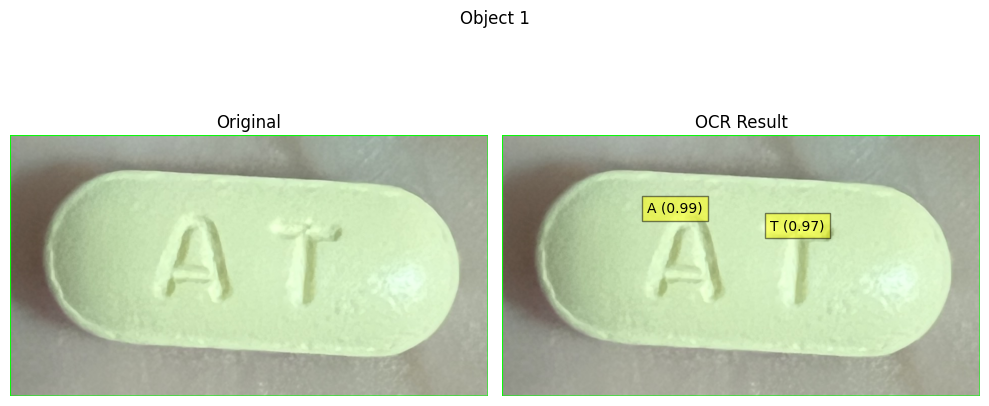


Processing KakaoTalk_20241009_134400839_07.jpg:

0: 640x480 3 pills, 7.0ms
Speed: 3.2ms preprocess, 7.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Detected text: P, Confidence: 0.07326631275441642
Detected text: 90, Confidence: 0.957348321660783


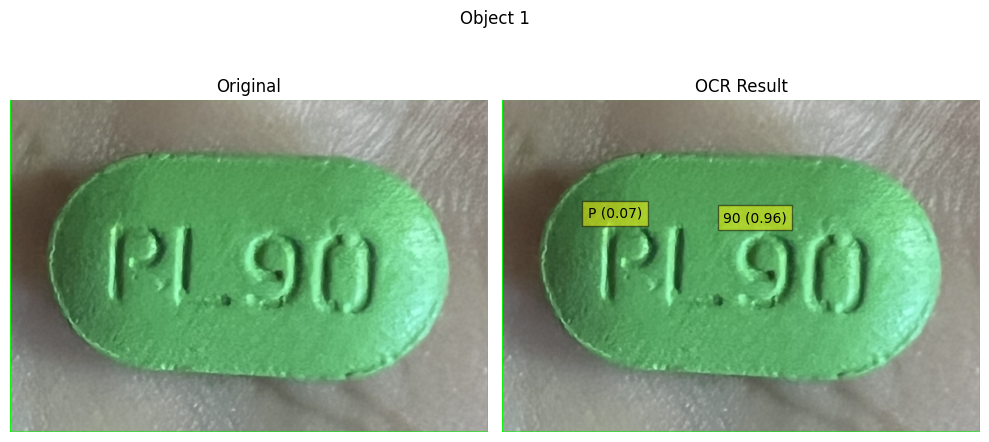

Detected text: XTX, Confidence: 0.22236531161634435


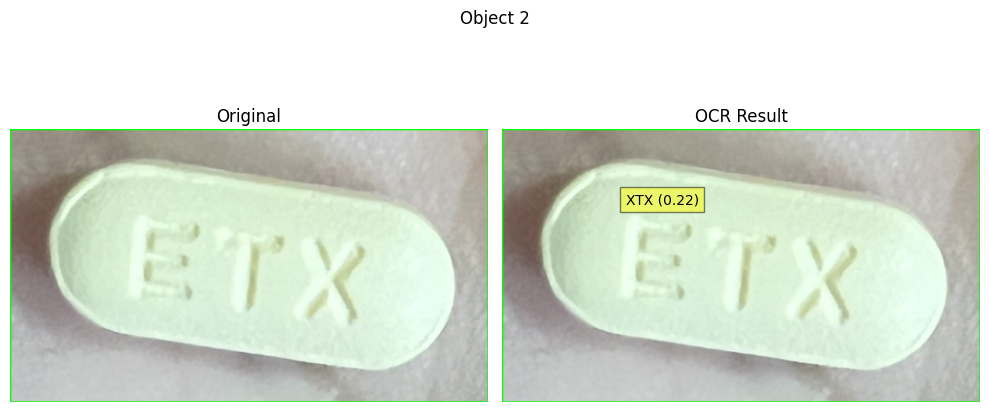

Detected text: CI, Confidence: 0.9557551295752493


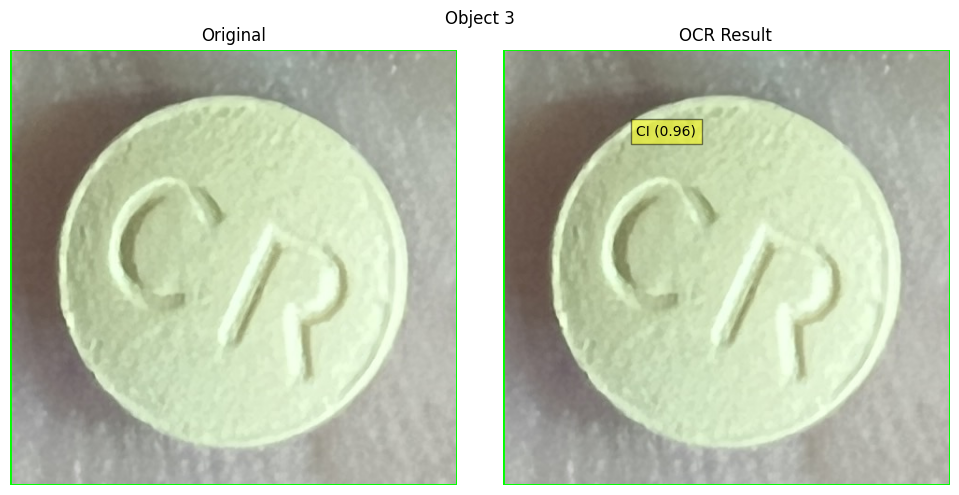


Processing KakaoTalk_20241009_134400839_05.jpg:

0: 640x480 1 pill, 7.5ms
Speed: 3.3ms preprocess, 7.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 8, Confidence: 0.009041544508534338
Detected text: 7, Confidence: 0.1790612972655845


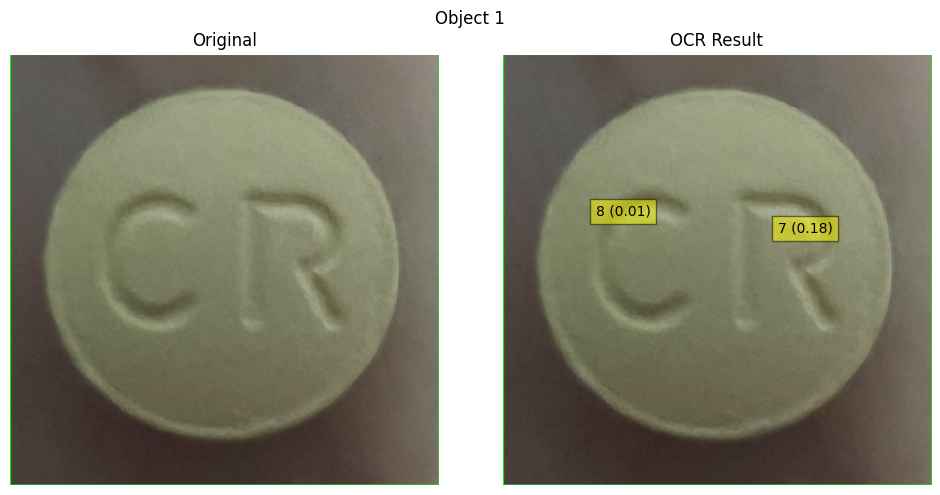


Processing KakaoTalk_20241009_134400839_06.jpg:

0: 640x480 3 pills, 7.3ms
Speed: 3.4ms preprocess, 7.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Detected text: P90, Confidence: 0.28120544446057616


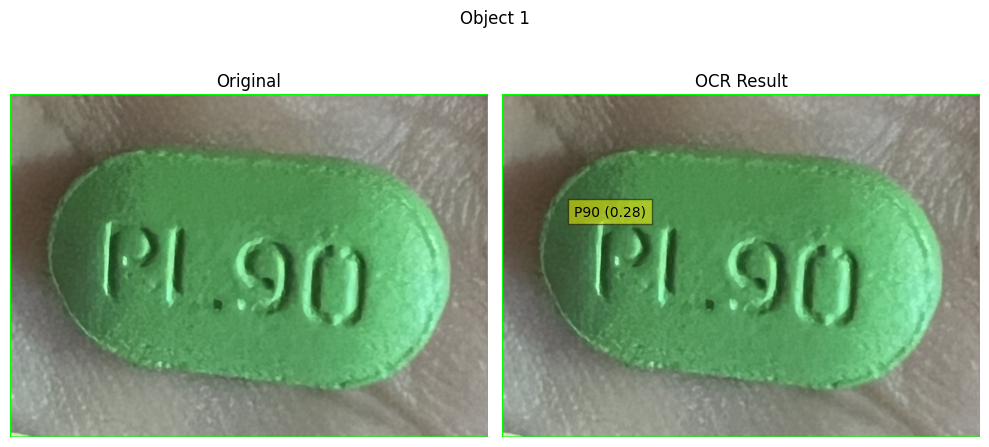

Detected text: CTX, Confidence: 0.22206992304902065


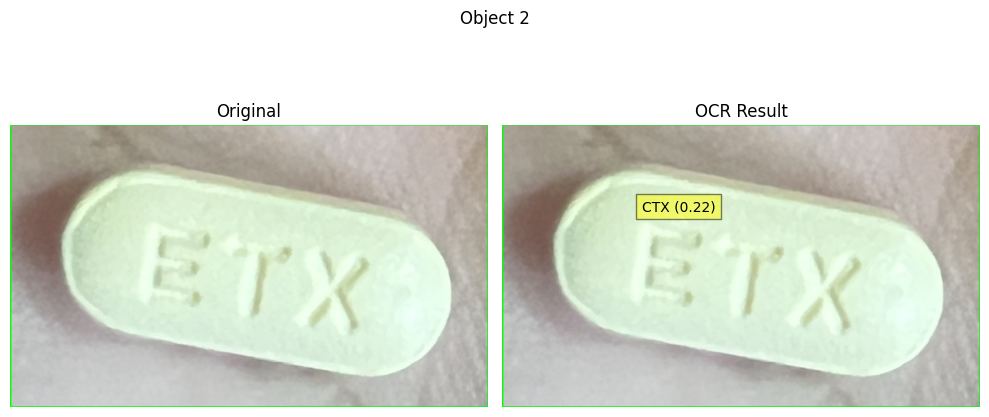

Detected text: C1, Confidence: 0.28379496297847134


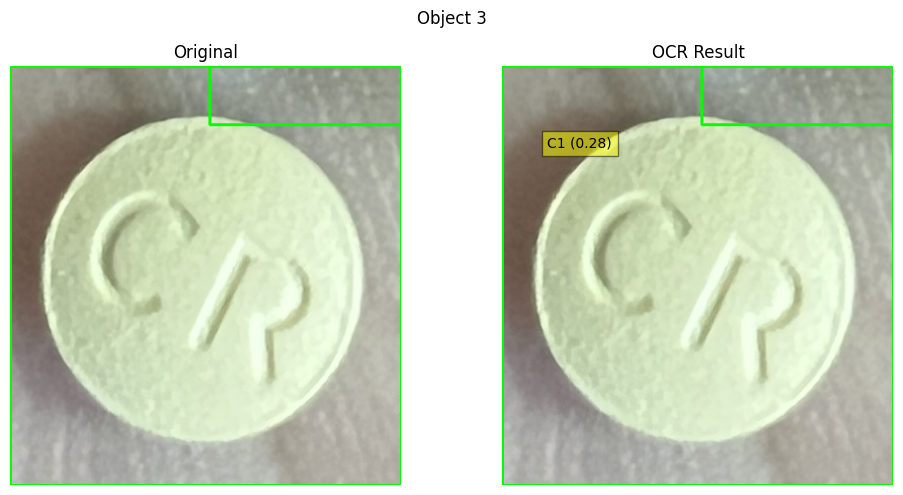


Processing KakaoTalk_20241009_134400839_03.jpg:

0: 640x480 1 pill, 7.3ms
Speed: 3.5ms preprocess, 7.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Detected text: 4, Confidence: 0.8415365890247273


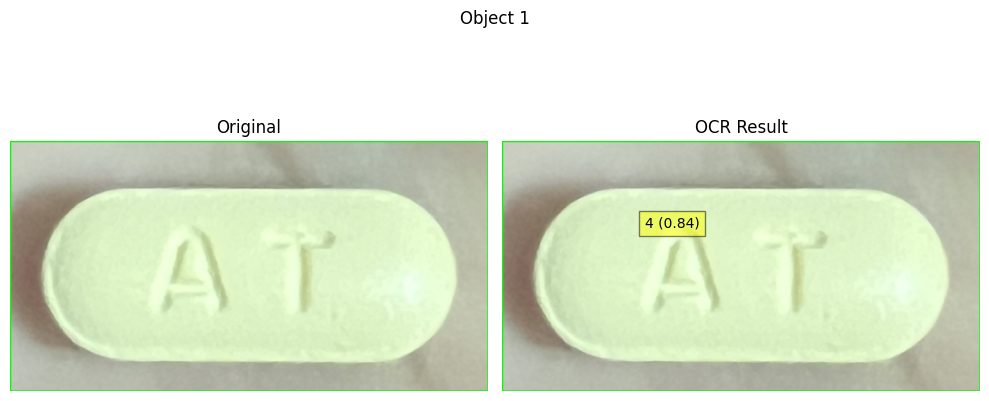


Processing KakaoTalk_20241009_134400839_04.jpg:

0: 640x480 1 pill, 7.9ms
Speed: 4.3ms preprocess, 7.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
Detected text: C, Confidence: 0.9630174155422857


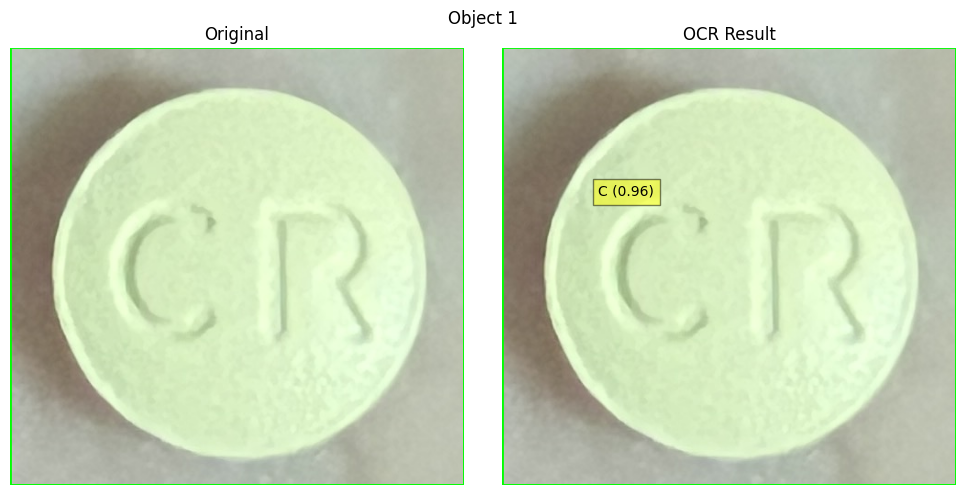


Processing KakaoTalk_20241009_134400839_02.jpg:

0: 640x480 1 pill, 7.1ms
Speed: 3.2ms preprocess, 7.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)
Detected text: PI, Confidence: 0.4554571358642089
Detected text: 90, Confidence: 0.7886358746892433


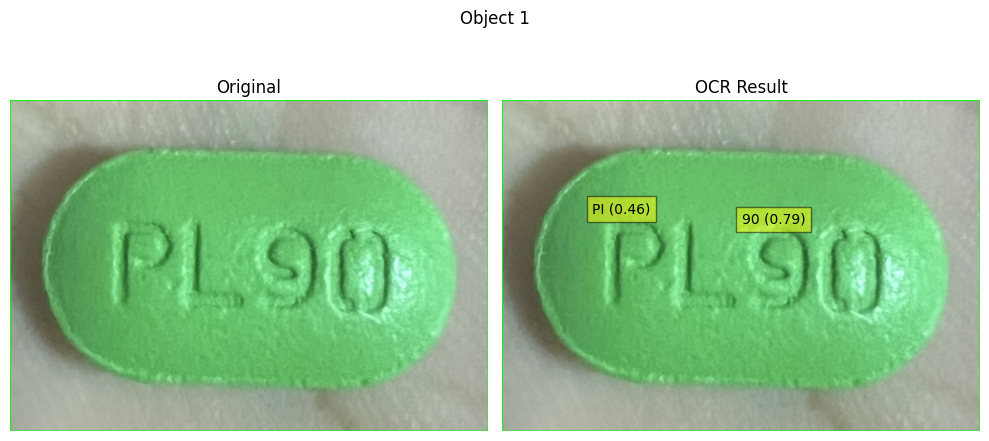


Processing KakaoTalk_20241009_134400839_01.jpg:

0: 640x480 1 pill, 9.2ms
Speed: 3.3ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)
Detected text: PL90, Confidence: 0.9361504912376404


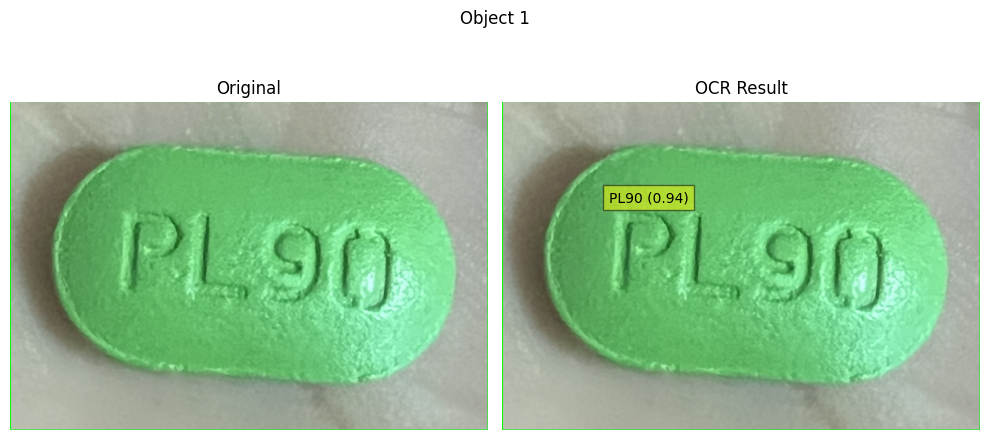


Overall Results:
KakaoTalk_20241009_134400839.jpg: 2 text regions detected
KakaoTalk_20241009_134400839_07.jpg: 4 text regions detected
KakaoTalk_20241009_134400839_05.jpg: 2 text regions detected
KakaoTalk_20241009_134400839_06.jpg: 3 text regions detected
KakaoTalk_20241009_134400839_03.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_04.jpg: 1 text regions detected
KakaoTalk_20241009_134400839_02.jpg: 2 text regions detected
KakaoTalk_20241009_134400839_01.jpg: 1 text regions detected

Average confidence across all detections: 0.5707


In [ ]:
## 원본 이미지로 ocr 테스트
## 필요한 라이브러리 import
import os
import cv2
import numpy as np
import easyocr
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import re

# 객체 검출 및 텍스트 인식 함수
def detect_and_recognize(image_path, yolo_model, ocr_reader):
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return []

    # YOLO 모델을 사용하여 객체(알약) 검출
    results = yolo_model(image)
    detected_texts = []

    # 검출된 각 객체에 대해 처리
    for i, box in enumerate(results[0].boxes):
        # 바운딩 박스 좌표 추출
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        # 원본 이미지에 바운딩 박스 그리기
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
        # 검출된 객체 영역 크롭
        cropped_image = image[y1:y2, x1:x2]

        # OCR 수행 (원본 이미지 사용)
        ocr_result = ocr_reader.readtext(
            cropped_image,
            detail=1,
            paragraph=False,
            min_size=20,
            contrast_ths=0.15,
            adjust_contrast=0.4,
            text_threshold=0.6,
            low_text=0.4,
            link_threshold=0.4,
            mag_ratio=1.2,
            allowlist='ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789'
        )

        # 결과 필터링 (특수문자 제거)
        filtered_result = []
        for (bbox, text, prob) in ocr_result:
            # 특수문자 제거 및 공백 제거
            cleaned_text = re.sub(r'[^A-Z0-9]', '', text)
            if cleaned_text:  # 빈 문자열이 아닌 경우에만 추가
                filtered_result.append((bbox, cleaned_text, prob))
                detected_texts.append((cleaned_text, prob))
                print(f"Detected text: {cleaned_text}, Confidence: {prob}")

        # 결과 시각화
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        fig.suptitle(f"Object {i+1}")

        # 원본 이미지 표시
        axes[0].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original")
        axes[0].axis('off')

        # OCR 결과 표시
        axes[1].imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        axes[1].set_title("OCR Result")
        axes[1].axis('off')
        for (bbox, text, prob) in filtered_result:
            (top_left, top_right, bottom_right, bottom_left) = bbox
            top_left = tuple(map(int, top_left))
            bottom_right = tuple(map(int, bottom_right))
            cv2.rectangle(cropped_image, top_left, bottom_right, (0, 255, 0), 2)
            axes[1].text(top_left[0], top_left[1], f"{text} ({prob:.2f})",
                         bbox=dict(facecolor='yellow', alpha=0.5))

        plt.tight_layout()
        plt.show()

    return detected_texts

# 메인 실행 코드
if __name__ == "__main__":
    # YOLO 모델 로드 (경로를 실제 모델 파일 위치로 변경해야 함)
    yolo_model = YOLO('/content/drive/MyDrive/yolo_checkpoints/pill/weights/best.pt')

    # EasyOCR 리더 초기화
    ocr_reader = easyocr.Reader(
        ['en'],  # 영어 텍스트 인식
        model_storage_directory='/content/drive/MyDrive/EASY/model2',  # 모델 저장 경로
        recog_network='english_g2',  # 사용할 인식 네트워크
    )

    # 이미지가 있는 폴더 경로 (실제 이미지 폴더 경로로 변경해야 함)
    folder_path = '/content/drive/MyDrive/pillimgtest/손바닥'

    # 결과를 저장할 딕셔너리
    results = {}

    # 폴더 내의 모든 이미지 파일에 대해 처리
    for filename in os.listdir(folder_path):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp', '.gif')):
            image_path = os.path.join(folder_path, filename)
            print(f"\nProcessing {filename}:")
            detected_texts = detect_and_recognize(image_path, yolo_model, ocr_reader)
            results[filename] = detected_texts

    # 전체 결과 요약
    print("\nOverall Results:")
    for filename, texts in results.items():
        print(f"{filename}: {len(texts)} text regions detected")

    # 평균 신뢰도 계산
    all_confidences = [prob for texts in results.values() for _, prob in texts]
    avg_confidence = np.mean(all_confidences) if all_confidences else 0
    print(f"\nAverage confidence across all detections: {avg_confidence:.4f}")

## 모델 평가 및 시각화

In [ ]:
!pip install python-Levenshtein

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 31.4 MB/s eta 0:00:00


In [ ]:
import os
import yaml
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import editdistance

# OCRDataset 클래스 정의 (이전 학습 스크립트에서 가져옴)
class OCRDataset(Dataset):
    def __init__(self, data_dir, config, reader):
        self.image_dir = os.path.join(data_dir, 'images')
        self.label_dir = os.path.join(data_dir, 'labels')
        self.image_files = [f for f in os.listdir(self.image_dir) if f.endswith(tuple(config['dataset']['image_extensions']))]
        self.config = config
        self.reader = reader
        self.cache = {}  # 새로 추가
        self.image_files = self.image_files[:100]  # 처음 100개의 이미지만 사용

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        if idx in self.cache:
            return self.cache[idx]

        try:
            image_name = self.image_files[idx]
            image_path = os.path.join(self.image_dir, image_name)
            label_path = os.path.join(self.label_dir, os.path.splitext(image_name)[0] + self.config['dataset']['label_extension'])

            # EasyOCR을 사용하여 텍스트 인식
            result = self.reader.readtext(image_path)
            recognized_text = ' '.join([text for _, text, _ in result])

            # 인식된 텍스트가 없으면 특별한 토큰 사용
            if not recognized_text:
                recognized_text = "<EMPTY>"

            with open(label_path, 'r', encoding='utf-8') as f:
                true_label = f.read().strip()

            # 레이블 파싱
            label_parts = true_label.split()
            if len(label_parts) >= 5:
                bbox = torch.tensor([float(x) for x in label_parts[1:5]])
                text_label = ' '.join(label_parts[5:]) if len(label_parts) > 5 else ""
            else:
                print(f"경고: {image_name}에 대한 레이블 형식이 잘못되었습니다. 기본값을 사용합니다.")
                bbox = torch.tensor([0.0, 0.0, 1.0, 1.0])  # 기본 바운딩 박스
                text_label = ""

            def char_to_index(c):
                if 'A' <= c <= 'Z':
                    return ord(c) - ord('A')
                elif 'a' <= c <= 'z':
                    return ord(c) - ord('a') + 26
                elif '0' <= c <= '9':
                    return ord(c) - ord('0') + 52
                else:
                    return 62  # 알 수 없는 문자나 패딩

            # recognized_text를 인코딩 (최대 50자)
            encoded_recognized_text = torch.tensor([char_to_index(c) for c in recognized_text[:50].ljust(50, ' ')], dtype=torch.long)

            # text_label 인코딩 (최대 50자)
            encoded_label = torch.tensor([char_to_index(c) for c in text_label[:50].ljust(50, ' ')], dtype=torch.long)

            return encoded_recognized_text, bbox, encoded_label

        except Exception as e:
            print(f"항목 {idx} 처리 중 오류 발생: {str(e)}")
            return None

# OCRModel 클래스 정의 (이전 학습 스크립트에서 가져옴)
class OCRModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes):
        super(OCRModel, self).__init__()
        self.embedding = nn.Embedding(input_size, hidden_size)
        self.lstm = nn.LSTM(hidden_size, hidden_size, batch_first=True, bidirectional=True)
        self.fc_text = nn.Linear(hidden_size * 2, num_classes)
        self.fc_bbox = nn.Linear(hidden_size * 2, 4)

    def forward(self, x):
        embedded = self.embedding(x)
        lstm_out, _ = self.lstm(embedded)
        text_output = self.fc_text(lstm_out)
        bbox_output = self.fc_bbox(lstm_out[:, -1, :])
        return text_output, bbox_output

def load_model(model_path, config):
    vocab_size = 63  # 영문 대소문자(52) + 숫자(10) + 알 수 없는 문자/패딩(1)
    hidden_size = 128
    num_classes = vocab_size
    model = OCRModel(vocab_size, hidden_size, num_classes)

    # CUDA 사용 가능 여부 확인
    use_cuda = config['misc']['use_cuda'] and torch.cuda.is_available()
    device = torch.device("cuda" if use_cuda else "cpu")

    # CPU에 모델 로드
    model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))

    model.to(device)
    model.eval()
    return model, device

def evaluate_model(model, data_loader, device):
    true_texts, pred_texts, true_bboxes, pred_bboxes = [], [], [], []

    with torch.no_grad():
        for recognized_texts, bboxes, text_labels in data_loader:
            recognized_texts = recognized_texts.to(device)
            bboxes = bboxes.to(device)

            text_outputs, bbox_outputs = model(recognized_texts)

            # 텍스트 예측 디코딩
            _, predicted = torch.max(text_outputs, 2)

            for i in range(recognized_texts.size(0)):
                true_text = ''.join([index_to_char(idx.item()) for idx in text_labels[i] if idx.item() != 62])
                pred_text = ''.join([index_to_char(idx.item()) for idx in predicted[i] if idx.item() != 62])

                true_texts.append(true_text)
                pred_texts.append(pred_text)
                true_bboxes.append(bboxes[i].cpu().numpy())
                pred_bboxes.append(bbox_outputs[i].cpu().numpy())

    return true_texts, pred_texts, true_bboxes, pred_bboxes

def calculate_metrics(true_texts, pred_texts, true_bboxes, pred_bboxes):
    char_accuracy = []
    word_accuracy = []
    cer = []  # Character Error Rate
    wer = []  # Word Error Rate
    iou_scores = []

    for true_text, pred_text, true_bbox, pred_bbox in zip(true_texts, pred_texts, true_bboxes, pred_bboxes):
        # 문자 정확도
        char_acc = sum(t == p for t, p in zip(true_text, pred_text)) / max(len(true_text), len(pred_text))
        char_accuracy.append(char_acc)

        # 단어 정확도
        word_acc = true_text.strip() == pred_text.strip()
        word_accuracy.append(word_acc)

        # CER (Character Error Rate)
        cer.append(editdistance.eval(true_text, pred_text) / len(true_text))

        # WER (Word Error Rate)
        true_words = true_text.split()
        pred_words = pred_text.split()
        wer.append(editdistance.eval(true_words, pred_words) / len(true_words))

        # IoU (Intersection over Union) for bounding boxes
        intersection = np.maximum(0, np.minimum(true_bbox[2:], pred_bbox[2:]) - np.maximum(true_bbox[:2], pred_bbox[:2]))
        union = (true_bbox[2] - true_bbox[0]) * (true_bbox[3] - true_bbox[1]) + \
                (pred_bbox[2] - pred_bbox[0]) * (pred_bbox[3] - pred_bbox[1]) - \
                intersection[0] * intersection[1]
        iou = intersection[0] * intersection[1] / union if union > 0 else 0
        iou_scores.append(iou)

    return {
        'char_accuracy': np.mean(char_accuracy),
        'word_accuracy': np.mean(word_accuracy),
        'cer': np.mean(cer),
        'wer': np.mean(wer),
        'iou': np.mean(iou_scores)
    }

def plot_confusion_matrix(true_chars, pred_chars):
    chars = sorted(list(set(true_chars + pred_chars)))
    cm = confusion_matrix(true_chars, pred_chars, labels=chars)
    plt.figure(figsize=(10, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=chars, yticklabels=chars)
    plt.title('Character Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

def visualize_predictions(images, true_texts, pred_texts, true_bboxes, pred_bboxes, num_samples=5):
    num_samples = min(num_samples, len(images))
    fig, axes = plt.subplots(num_samples, 1, figsize=(15, 5*num_samples))

    if num_samples == 1:
        axes = [axes]

    for i in range(num_samples):
        ax = axes[i]
        ax.imshow(images[i])

        true_bbox = true_bboxes[i]
        pred_bbox = pred_bboxes[i]

        ax.add_patch(plt.Rectangle((true_bbox[0], true_bbox[1]), true_bbox[2]-true_bbox[0], true_bbox[3]-true_bbox[1],
                                   fill=False, edgecolor='green', linewidth=2, label='True'))
        ax.add_patch(plt.Rectangle((pred_bbox[0], pred_bbox[1]), pred_bbox[2]-pred_bbox[0], pred_bbox[3]-pred_bbox[1],
                                   fill=False, edgecolor='red', linewidth=2, label='Predicted'))

        ax.text(0.05, 0.95, f'True: {true_texts[i]}\nPred: {pred_texts[i]}',
                transform=ax.transAxes, fontsize=12, verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

        ax.set_title(f'Sample {i+1}')
        ax.axis('off')

    plt.tight_layout()
    plt.show()

def index_to_char(index):
    if 0 <= index < 26:
        return chr(index + ord('A'))
    elif 26 <= index < 52:
        return chr(index - 26 + ord('a'))
    elif 52 <= index < 62:
        return chr(index - 52 + ord('0'))
    else:
        return ''

if __name__ == '__main__':
    # 설정 파일 로드
    with open('/content/drive/MyDrive/EASY/config.yaml', 'r') as f:
        config = yaml.safe_load(f)

    print(f"CUDA is available: {torch.cuda.is_available()}")
    print(f"CUDA will be used: {config['misc']['use_cuda'] and torch.cuda.is_available()}")

    # 모델 로드
    model_path = '/content/drive/MyDrive/EASY/model/custom_model_epoch_20.pth'
    model, device = load_model(model_path, config)

    # 평가 데이터셋 준비
    reader = easyocr.Reader(['en'], gpu=False)  # GPU 사용을 명시적으로 비활성화
    eval_dataset = OCRDataset(config['dataset']['val_data_dir'], config, reader)

    # DataLoader 설정 (이 부분을 완전히 대체하세요)
    eval_loader = DataLoader(eval_dataset,
                             batch_size=1,
                             shuffle=False,
                             num_workers=0,
                             pin_memory=False)

    # 모델 평가
    true_texts, pred_texts, true_bboxes, pred_bboxes = evaluate_model(model, eval_loader, device)

    # 메트릭 계산
    metrics = calculate_metrics(true_texts, pred_texts, true_bboxes, pred_bboxes)

    # 결과 출력
    print("Evaluation Metrics:")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}")

    # 혼동 행렬 시각화
    true_chars = [char for text in true_texts for char in text]
    pred_chars = [char for text in pred_texts for char in text]
    plot_confusion_matrix(true_chars, pred_chars)

    # 예측 결과 시각화
    eval_images = [Image.open(os.path.join(config['dataset']['val_data_dir'], 'images', f"{os.path.splitext(os.path.basename(eval_dataset.image_files[i]))[0]}.jpg")) for i in range(10)]
    visualize_predictions(eval_images, true_texts[:10], pred_texts[:10], true_bboxes[:10], pred_bboxes[:10])

<ipython-input-12-28e72db76db4>:106: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))


CUDA is available: False
CUDA will be used: False
Evaluation Metrics:
char_accuracy: 0.0000
word_accuracy: 0.0000
cer: 1.0000
wer: 1.0000
iou: 0.0000


ValueError: Found input variables with inconsistent numbers of samples: [350, 3]